### segment waveform into individual syllables using dynamic thresholding
- 

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
import pandas as pd
from datetime import datetime

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [3]:
import warnings
warnings.filterwarnings(action='once')

In [4]:
from avgn.utils.audio import load_wav, read_wav
from avgn.signalprocessing.filtering import butter_bandpass_filter
from vocalseg.dynamic_thresholding import dynamic_threshold_segmentation
from vocalseg.dynamic_thresholding import plot_segmented_spec, plot_segmentations

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)


In [5]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir

In [6]:
from avgn.utils.hparams import HParams
from avgn.dataset import DataSet

In [7]:
DATASET_ID = 'insect_dataset_cricket'

### Load data in original format

In [8]:
# create a unique datetime identifier for the files output by this notebook
DT_ID = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
DT_ID

'2019-10-08_09-51-58'

### create dataset

In [9]:
hparams = HParams(
    n_fft = 4096,
    mel_lower_edge_hertz=50,
    mel_upper_edge_hertz=20000,
    butter_lowcut = 500,
    butter_highcut = 20000,
    ref_level_db = 20,
    min_level_db = -100,
    win_length_ms = 4,
    hop_length_ms = 1,
    n_jobs = -1,
    verbosity=1,
    nex = -1
)

In [10]:
# create a dataset object
dataset = DataSet(DATASET_ID, hparams = hparams)

/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/avgn/utils/json.py:64: ResourceWarning: unclosed file <_io.TextIOWrapper name='/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/processed/insect_dataset_cricket/2019-06-26_16-00-45/JSON/CR_kinhibari.JSON' mode='r' encoding='UTF-8'>
  return json.load(open(json_loc), object_pairs_hook=OrderedDict)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   12.6s


[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:   12.8s finished


/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: ImportWarning: can't resolve package from __spec__ or __package__, falling back on __name__ and __path__
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tensorflow/python/keras/backend.py:5605: ResourceWarning: unclosed file <_io.TextIOWrapper name='/home/AD/tsainbur/.keras/keras.json' mode='r' encoding='UTF-8'>
  _config = json.load(open(_config_path))
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 88 from C header, got 96 from PyObject
  return f(*args, **kwds)
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tensorflow/python/ops/signal/util_ops.py:62: DeprecationWarning: fractions.gcd() is deprecated. Use math.gcd() instead.
  return ops.convert_to_tensor(fractions.gcd(const_a, const_b))


In [12]:
dataset.sample_json

OrderedDict([('species_id', 'kinhibari'),
             ('species', 'Gryllidae sp.'),
             ('common_name', 'cricket'),
             ('wav_loc', '/mnt/cube/Datasets/insectORIG/CR_kinhibari.wav'),
             ('samplerate_hz', 44100),
             ('length_s', 20.45387755102041),
             ('indvs', OrderedDict([('kinhibari', OrderedDict())]))])

In [77]:
### segmentation parameters
n_fft=1024
hop_length_ms=1
win_length_ms=3
ref_level_db=20
pre=0.97
min_level_db=-40
min_level_db_floor = -5
db_delta = 5
silence_threshold = 0.25
min_silence_for_spec=0.25
max_vocal_for_spec=0.05,
min_syllable_length_s = 0.0025,
butter_min = 500
butter_max = 15000
spectral_range = [500, 15000]

In [78]:
import librosa

In [79]:
rate, data = load_wav(dataset.sample_json["wav_loc"])

In [80]:
data = data[:rate*15]

In [81]:
rate

44100

In [82]:
np.min(data), np.max(data)

(-0.24513245, 0.32736206)

In [83]:
data = data / np.max(np.abs(data))

In [84]:
# filter data
data = butter_bandpass_filter(data, butter_min, butter_max, rate)

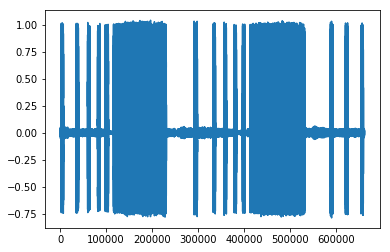

In [85]:
plt.plot(data)

In [86]:
# segment
results = dynamic_threshold_segmentation(
    data,
    rate,
    n_fft=n_fft,
    hop_length_ms=hop_length_ms,
    win_length_ms=win_length_ms,
    min_level_db_floor=min_level_db_floor,
    db_delta=db_delta,
    ref_level_db=ref_level_db,
    pre=pre,
    min_silence_for_spec=min_silence_for_spec,
    max_vocal_for_spec=max_vocal_for_spec,
    min_level_db=min_level_db,
    silence_threshold=silence_threshold,
    verbose=True,
    min_syllable_length_s=min_syllable_length_s,
    spectral_range=spectral_range,
)

longest silence 1.3550000000000004
longest vocalization 0.031000000000000583


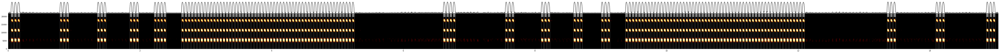

In [87]:
plot_segmentations(
    results["spec"],
    results["vocal_envelope"],
    results["onsets"],
    results["offsets"],
    hop_length_ms,
    rate,
    figsize=(100,5)
)
plt.show()

### segment and plot 
- for each json, load the wav file - segment the file into start and end times
- plot the segmentation
- add to the JSON 

In [88]:
import joblib

In [89]:
from avgn.utils.json import NoIndent, NoIndentEncoder

In [90]:
warnings.filterwarnings("ignore", message = "'tqdm_notebook' object has no attribute 'sp'")

def segment_spec_custom(key, df, save=False, plot=False):
    # load wav
    rate, data = load_wav(df.data["wav_loc"])
    # filter data
    data = butter_bandpass_filter(data, butter_min, butter_max, rate)

    # segment
    results = dynamic_threshold_segmentation(
        data,
        rate,
        n_fft=n_fft,
        hop_length_ms=hop_length_ms,
        win_length_ms=win_length_ms,
        min_level_db_floor=min_level_db_floor,
        db_delta=db_delta,
        ref_level_db=ref_level_db,
        pre=pre,
        min_silence_for_spec=min_silence_for_spec,
        max_vocal_for_spec=max_vocal_for_spec,
        min_level_db=min_level_db,
        silence_threshold=silence_threshold,
        verbose=True,
        min_syllable_length_s=min_syllable_length_s,
        spectral_range=spectral_range,
    )
    if results is None:
        return
    if plot:
        plot_segmentations(
            results["spec"],
            results["vocal_envelope"],
            results["onsets"],
            results["offsets"],
            hop_length_ms,
            rate,
            figsize=(100, 5)
        )
        plt.show()

    # save the results
    json_out = DATA_DIR / "processed" / (DATASET_ID + "_segmented") / DT_ID / "JSON" / (
        key + ".JSON"
    )

    json_dict = df.data.copy()

    json_dict["indvs"][list(df.data["indvs"].keys())[0]]["syllables"] = {
        "start_times": NoIndent(list(results["onsets"])),
        "end_times": NoIndent(list(results["offsets"])),
    }

    json_txt = json.dumps(json_dict, cls=NoIndentEncoder, indent=2)
    # save json
    if save:
        ensure_dir(json_out.as_posix())
        print(json_txt, file=open(json_out.as_posix(), "w"))

    print(json_txt)

    return results

In [91]:
indvs = np.array(['_'.join(list(i)) for i in dataset.json_indv])
np.unique(indvs)

array(['437ss', '438ss', '440ss', '441ss', '442ss', '443ss', '446ss',
       '450ss', '452ss', '453ss', '454ss', '462sl', '464sldw', '465ssdw',
       '466ssdw', '467ssdw', '468ssdw', '470ss', '475scl', '475sct',
       '479scdg', '479ss', '480ssdw1', '480ssdw2', '481ss', '482scdg',
       '483ss', '484ss', '487sl', '488ss', '489ss', '491srds', '491ss',
       '492ss', '499sl', '501ss', '521ss', '521ss2', '551ss', '575sl',
       '577sl', '581ss', '582ss', '583ss', '585ss', '585ssh', '585ssj',
       '585sso', '586ss', '587ss', '588ss', '589ss', '590ss', '591sl',
       '592ss', '593ss', '594ss', '601ss', '610ss', '611ss', '612ss',
       '613ss', '614ss', '615ss', '616ss', '617ss', '618ss', '619ss',
       '621ss', '622ss', '623ss', '624ss', '630ss', '632ss', '641ss',
       '671ss', '672ss', '679ss', '681ss', '682ss', '683ss', '684ss',
       '685ss', '686ss', 'black-horned', 'enma-koorogi', 'ezo-enma',
       'ezo-suzu', 'fall', 'fieldcricket1', 'hama-suzu', 'haraokame',
       'him

437ss


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/scipy/signal/signaltools.py:1344: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out = out_full[ind]


longest silence 0.6210000000000004
longest vocalization 0.017000000000000348


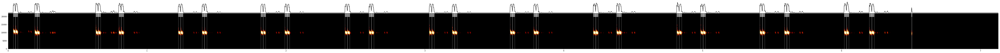

{
  "species_id": "437ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_437ss.wav",
  "samplerate_hz": 44100,
  "length_s": 7.1112471655328795,
  "indvs": {
    "437ss": {
      "syllables": {
        "start_times": [0.037, 0.054, 0.192, 0.21, 0.631, 0.649, 0.797, 0.815, 1.225, 1.243, 1.397, 1.415, 1.819, 1.838, 1.992, 2.01, 2.425, 2.444, 2.598, 2.616, 3.032, 3.052, 3.198, 3.216, 3.614, 3.632, 3.784, 3.802, 4.213, 4.231, 4.381, 4.399, 4.814, 4.832, 4.986, 5.004, 5.412, 5.431, 5.589, 5.607, 6.019, 6.037, 6.2, 6.219, 6.504],
        "end_times": [0.052, 0.07, 0.209, 0.227, 0.648, 0.666, 0.813, 0.832, 1.241, 1.259, 1.413, 1.431, 1.835, 1.854, 2.009, 2.027, 2.442, 2.46, 2.615, 2.633, 3.049, 3.067, 3.214, 3.232, 3.631, 3.648, 3.801, 3.818, 4.23, 4.248, 4.398, 4.415, 4.831, 4.849, 5.003, 5.021, 5.429, 5.447, 5.606, 5.623, 6.035, 6.053, 6.217, 6.235, 6.507]
      }
    }
  }
}
438ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.0350000000000006
longest vocalization 0.014000000000000234


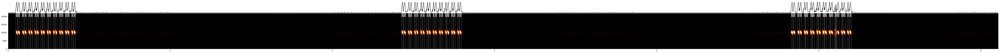

{
  "species_id": "438ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_438ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.093832199546485,
  "indvs": {
    "438ss": {
      "syllables": {
        "start_times": [0.047, 0.06, 0.086, 0.102, 0.126, 0.14, 0.164, 0.178, 0.202, 0.215, 0.24, 0.25, 0.278, 0.291, 0.315, 0.329, 0.353, 0.366, 0.391, 0.405, 2.427, 2.44, 2.468, 2.481, 2.506, 2.519, 2.544, 2.558, 2.583, 2.596, 2.621, 2.634, 2.659, 2.672, 2.696, 2.707, 2.734, 2.748, 2.772, 2.785, 4.831, 4.844, 4.869, 4.885, 4.911, 4.921, 4.95, 4.96, 4.988, 4.998, 5.026, 5.036, 5.064, 5.075, 5.099, 5.106, 5.113, 5.14, 5.15, 5.177, 5.191],
        "end_times": [0.058, 0.072, 0.097, 0.112, 0.135, 0.15, 0.173, 0.188, 0.211, 0.225, 0.248, 0.263, 0.286, 0.301, 0.324, 0.339, 0.362, 0.377, 0.4, 0.415, 2.437, 2.452, 2.477, 2.491, 2.514, 2.529, 2.553, 2.568, 2.591, 2.606, 2.629, 2.644, 2.667, 2.682, 2.705, 2.72, 2.743, 2.758, 2.781, 2.796, 4.841, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.093
longest vocalization 0.018999999999999684


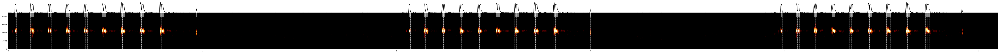

{
  "species_id": "440ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_440ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.092108843537415,
  "indvs": {
    "440ss": {
      "syllables": {
        "start_times": [0.035, 0.115, 0.123, 0.205, 0.214, 0.297, 0.305, 0.39, 0.399, 0.485, 0.493, 0.581, 0.589, 0.68, 0.688, 0.781, 0.79, 0.969, 2.065, 2.145, 2.154, 2.236, 2.244, 2.328, 2.336, 2.421, 2.43, 2.515, 2.611, 2.62, 2.71, 2.719, 2.812, 2.821, 2.999, 3.983, 4.062, 4.071, 4.153, 4.161, 4.245, 4.253, 4.338, 4.347, 4.433, 4.441, 4.528, 4.537, 4.627, 4.636, 4.729, 4.738],
        "end_times": [0.043, 0.121, 0.132, 0.212, 0.223, 0.304, 0.316, 0.397, 0.409, 0.492, 0.504, 0.588, 0.601, 0.687, 0.701, 0.789, 0.803, 0.972, 2.074, 2.152, 2.163, 2.243, 2.253, 2.335, 2.346, 2.428, 2.439, 2.534, 2.618, 2.632, 2.718, 2.732, 2.82, 2.833, 3.002, 3.991, 4.069, 4.08, 4.16, 4.17, 4.252, 4.263, 4.345, 4.356, 4.44, 4.452, 4.535, 4.549, 4.635, 4.649

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.357
longest vocalization 0.03100000000000014


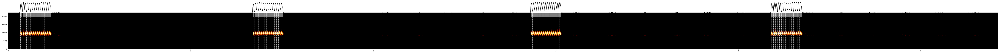

{
  "species_id": "441ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_441ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.41092970521542,
  "indvs": {
    "441ss": {
      "syllables": {
        "start_times": [0.067, 0.08, 0.103, 0.113, 0.125, 0.135, 0.148, 0.158, 0.169, 0.18, 0.191, 0.202, 0.213, 0.224, 1.34, 1.352, 1.374, 1.395, 1.406, 1.417, 1.428, 1.461, 1.471, 1.484, 1.495, 2.863, 2.876, 2.886, 2.898, 2.908, 2.92, 2.93, 2.942, 2.964, 2.985, 2.996, 3.008, 3.019, 4.181, 4.193, 4.203, 4.216, 4.226, 4.239, 4.249, 4.261, 4.282, 4.293, 4.305, 4.315, 4.327, 4.337],
        "end_times": [0.077, 0.1, 0.112, 0.123, 0.134, 0.146, 0.157, 0.168, 0.178, 0.189, 0.2, 0.211, 0.222, 0.235, 1.349, 1.372, 1.394, 1.405, 1.416, 1.427, 1.459, 1.47, 1.481, 1.494, 1.506, 2.873, 2.885, 2.896, 2.907, 2.918, 2.929, 2.94, 2.962, 2.984, 2.995, 3.006, 3.018, 3.03, 4.19, 4.202, 4.214, 4.225, 4.236, 4.248, 4.259, 4.281, 4.291, 4.303, 4.314, 4.325, 4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.5829999999999997
longest vocalization 0.030999999999999694


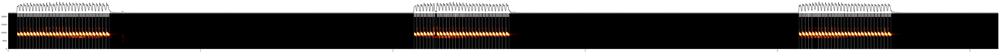

{
  "species_id": "442ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_442ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.136281179138322,
  "indvs": {
    "442ss": {
      "syllables": {
        "start_times": [0.047, 0.063, 0.081, 0.098, 0.114, 0.131, 0.148, 0.164, 0.181, 0.198, 0.215, 0.233, 0.249, 0.267, 0.283, 0.301, 0.318, 0.335, 0.352, 0.37, 0.387, 0.404, 0.421, 0.439, 0.457, 0.474, 0.492, 0.51, 2.11, 2.126, 2.144, 2.161, 2.179, 2.195, 2.212, 2.229, 2.244, 2.262, 2.279, 2.296, 2.312, 2.327, 2.347, 2.364, 2.381, 2.398, 2.415, 2.432, 2.45, 2.467, 2.484, 2.502, 2.519, 2.536, 2.554, 2.571, 2.589, 4.112, 4.129, 4.146, 4.162, 4.181, 4.214, 4.231, 4.248, 4.265, 4.282, 4.299, 4.315, 4.333, 4.35, 4.367, 4.384, 4.401, 4.419, 4.436, 4.453, 4.471, 4.488, 4.505, 4.522, 4.54, 4.557, 4.575],
        "end_times": [0.059, 0.076, 0.094, 0.111, 0.128, 0.145, 0.161, 0.177, 0.194, 0.211, 0.229, 0.246, 0.263, 0.281, 0.298, 0.315, 0.332, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


/mnt/cube/tsainbur/Projects/github_repos/vocalization_segmentation/vocalseg/dynamic_thresholding.py:129: RuntimeWarning: invalid value encountered in sqrt
  vocal_envelope = np.max(spec, axis=0) * np.sqrt(np.mean(spec, axis=0))


longest silence 0.9859999999999989
longest vocalization 0.016000000000000014


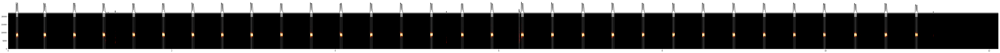

{
  "species_id": "443ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_443ss.wav",
  "samplerate_hz": 44100,
  "length_s": 12.081768707482993,
  "indvs": {
    "443ss": {
      "syllables": {
        "start_times": [0.096, 0.109, 0.434, 0.448, 0.797, 0.811, 1.156, 1.17, 1.521, 1.535, 1.885, 1.899, 2.245, 2.259, 2.605, 2.62, 2.965, 2.979, 3.329, 3.343, 3.694, 3.708, 4.058, 4.072, 4.428, 4.442, 4.796, 4.81, 5.164, 5.179, 5.541, 5.555, 5.904, 5.919, 6.249, 6.275, 6.29, 6.644, 6.658, 7.017, 7.032, 7.382, 7.397, 7.752, 7.767, 8.126, 8.14, 8.489, 8.503, 8.862, 8.876, 9.234, 9.248, 9.603, 9.617, 9.97, 9.985, 10.349, 10.364, 10.722, 10.737, 11.096, 11.111],
        "end_times": [0.107, 0.121, 0.446, 0.463, 0.809, 0.826, 1.169, 1.186, 1.534, 1.551, 1.898, 1.915, 2.258, 2.275, 2.618, 2.634, 2.977, 2.994, 3.342, 3.357, 3.707, 3.723, 4.071, 4.087, 4.441, 4.456, 4.809, 4.825, 5.177, 5.192, 5.554, 5.569, 5.917, 5.933, 6.252, 6.289, 6.305, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.217
longest vocalization 0.0259999999999998


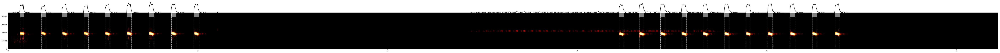

{
  "species_id": "446ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_446ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.208707482993197,
  "indvs": {
    "446ss": {
      "syllables": {
        "start_times": [0.062, 0.175, 0.285, 0.399, 0.512, 0.626, 0.743, 0.861, 0.981, 3.222, 3.328, 3.44, 3.552, 3.664, 3.777, 3.891, 4.006, 4.124, 4.241, 4.36],
        "end_times": [0.083, 0.198, 0.31, 0.423, 0.536, 0.651, 0.768, 0.885, 1.005, 3.247, 3.353, 3.465, 3.577, 3.689, 3.803, 3.913, 4.031, 4.149, 4.265, 4.385]
      }
    }
  }
}
450ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.8659999999999999
longest vocalization 0.019000000000000128


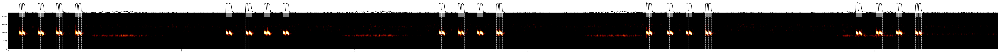

{
  "species_id": "450ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_450ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.702766439909297,
  "indvs": {
    "450ss": {
      "syllables": {
        "start_times": [0.064, 0.082, 0.173, 0.191, 0.278, 0.296, 0.388, 0.406, 1.257, 1.275, 1.371, 1.389, 1.478, 1.496, 1.587, 1.605, 2.488, 2.505, 2.598, 2.616, 2.708, 2.725, 2.819, 2.836, 3.684, 3.702, 3.803, 3.821, 3.913, 3.931, 4.026, 4.044, 4.894, 4.911, 5.012, 5.029, 5.126, 5.144, 5.238, 5.256],
        "end_times": [0.078, 0.099, 0.187, 0.208, 0.293, 0.313, 0.403, 0.423, 1.274, 1.293, 1.388, 1.408, 1.493, 1.513, 1.602, 1.622, 2.502, 2.523, 2.613, 2.634, 2.722, 2.743, 2.834, 2.854, 3.7, 3.719, 3.818, 3.84, 3.927, 3.949, 4.04, 4.06, 4.91, 4.93, 5.026, 5.047, 5.141, 5.161, 5.253, 5.273]
      }
    }
  }
}
452ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3540000000000001
longest vocalization 0.020000000000000018


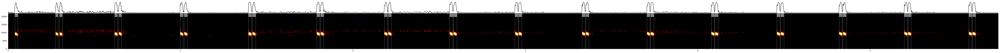

{
  "species_id": "452ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_452ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.729795918367347,
  "indvs": {
    "452ss": {
      "syllables": {
        "start_times": [0.039, 0.275, 0.298, 0.618, 0.641, 0.998, 1.021, 1.394, 1.417, 1.79, 1.813, 2.182, 2.205, 2.561, 2.583, 2.94, 2.961, 3.329, 3.351, 3.705, 3.727, 4.079, 4.1, 4.459, 4.482, 4.82, 4.842, 5.198, 5.22, 5.572, 5.594],
        "end_times": [0.056, 0.29, 0.314, 0.634, 0.658, 1.015, 1.04, 1.412, 1.436, 1.808, 1.83, 2.2, 2.222, 2.579, 2.603, 2.958, 2.98, 3.347, 3.369, 3.723, 3.746, 4.097, 4.118, 4.477, 4.5, 4.838, 4.861, 5.217, 5.238, 5.59, 5.612]
      }
    }
  }
}
453ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.6150000000000002
longest vocalization 0.01499999999999968


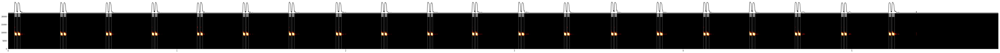

{
  "species_id": "453ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_453ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.853877551020408,
  "indvs": {
    "453ss": {
      "syllables": {
        "start_times": [0.038, 0.057, 0.31, 0.329, 0.58, 0.6, 0.852, 0.871, 1.12, 1.14, 1.392, 1.411, 1.664, 1.683, 1.943, 1.962, 2.212, 2.232, 2.485, 2.505, 2.75, 2.77, 3.025, 3.044, 3.295, 3.314, 3.574, 3.594, 3.845, 3.864, 4.121, 4.139, 4.394, 4.413, 4.663, 4.682, 4.938, 4.957, 5.219, 5.238],
        "end_times": [0.051, 0.071, 0.323, 0.343, 0.593, 0.612, 0.865, 0.884, 1.133, 1.153, 1.405, 1.424, 1.677, 1.696, 1.956, 1.975, 2.225, 2.245, 2.498, 2.517, 2.763, 2.783, 3.038, 3.057, 3.308, 3.327, 3.587, 3.607, 3.858, 3.878, 4.133, 4.154, 4.407, 4.427, 4.676, 4.696, 4.951, 4.97, 5.233, 5.253]
      }
    }
  }
}
454ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.384
longest vocalization 0.03900000000000059


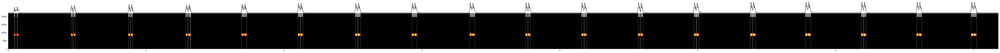

{
  "species_id": "454ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_454ss.wav",
  "samplerate_hz": 44100,
  "length_s": 7.162902494331066,
  "indvs": {
    "454ss": {
      "syllables": {
        "start_times": [0.044, 0.063, 0.456, 0.474, 0.871, 0.89, 1.289, 1.308, 1.321, 1.694, 2.102, 2.121, 2.517, 2.537, 2.928, 3.348, 3.752, 3.772, 4.158, 4.177, 4.568, 4.588, 4.973, 4.992, 5.382, 5.401, 5.782, 6.186, 6.205, 6.588, 6.983],
        "end_times": [0.049, 0.069, 0.468, 0.487, 0.884, 0.903, 1.301, 1.32, 1.324, 1.731, 2.119, 2.138, 2.535, 2.554, 2.965, 3.385, 3.766, 3.787, 4.176, 4.196, 4.582, 4.603, 4.991, 5.01, 5.4, 5.42, 5.82, 6.204, 6.222, 6.625, 7.022]
      }
    }
  }
}
462sl


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.636000000000001
longest vocalization 0.015000000000000568


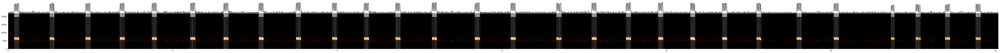

{
  "species_id": "462sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_462sl.wav",
  "samplerate_hz": 44100,
  "length_s": 12.003854875283446,
  "indvs": {
    "462sl": {
      "syllables": {
        "start_times": [0.074, 0.089, 0.104, 0.119, 0.506, 0.52, 0.535, 0.551, 0.941, 0.955, 0.971, 0.986, 1.357, 1.371, 1.386, 1.401, 1.747, 1.762, 1.777, 1.793, 2.214, 2.229, 2.244, 2.259, 2.618, 2.632, 2.647, 2.663, 3.046, 3.06, 3.076, 3.091, 3.498, 3.512, 3.528, 3.543, 3.938, 3.952, 3.968, 3.983, 4.325, 4.339, 4.355, 4.37, 4.708, 4.722, 4.737, 4.752, 5.151, 5.165, 5.18, 5.196, 5.671, 5.686, 5.701, 5.718, 6.108, 6.122, 6.138, 6.153, 6.663, 6.677, 6.693, 6.709, 7.092, 7.106, 7.121, 7.137, 7.509, 7.523, 7.538, 7.554, 7.9, 7.914, 7.93, 7.945, 8.292, 8.306, 8.322, 8.337, 8.678, 8.693, 8.708, 8.723, 9.096, 9.11, 9.125, 9.14, 9.583, 9.597, 9.612, 9.628, 10.034, 10.048, 10.064, 10.08, 10.73, 10.742, 10.758, 11.03, 11.043, 11.059, 11.074, 11.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5680000000000005
longest vocalization 0.02800000000000047


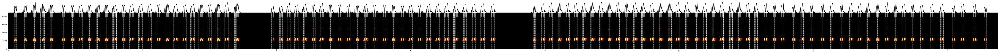

{
  "species_id": "464sldw",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_464sldw.wav",
  "samplerate_hz": 44100,
  "length_s": 14.721451247165533,
  "indvs": {
    "464sldw": {
      "syllables": {
        "start_times": [0.086, 0.106, 0.232, 0.254, 0.368, 0.391, 0.412, 0.483, 0.5, 0.524, 0.544, 0.605, 0.62, 0.644, 0.789, 0.804, 0.825, 0.937, 0.959, 1.059, 1.084, 1.172, 1.187, 1.211, 1.318, 1.341, 1.439, 1.464, 1.55, 1.568, 1.593, 1.614, 1.694, 1.719, 1.805, 1.819, 1.844, 1.937, 1.955, 1.978, 2.088, 2.111, 2.203, 2.218, 2.242, 2.348, 2.371, 2.461, 2.477, 2.5, 2.608, 2.631, 2.714, 2.729, 2.753, 2.839, 2.855, 2.879, 2.964, 2.979, 3.003, 3.092, 3.107, 3.131, 3.216, 3.233, 3.258, 3.372, 3.389, 3.413, 3.925, 3.952, 4.044, 4.067, 4.159, 4.182, 4.263, 4.278, 4.301, 4.4, 4.424, 4.527, 4.551, 4.652, 4.675, 4.779, 4.803, 4.916, 4.94, 5.052, 5.075, 5.166, 5.183, 5.205, 5.309, 5.333, 5.439, 5.462, 5.571, 5.589, 5.611, 5.718, 5.741, 5.855

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3610000000000001
longest vocalization 0.028000000000000025


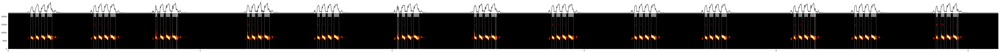

{
  "species_id": "465ssdw",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_465ssdw.wav",
  "samplerate_hz": 44100,
  "length_s": 5.144580498866213,
  "indvs": {
    "465ssdw": {
      "syllables": {
        "start_times": [0.117, 0.143, 0.173, 0.204, 0.446, 0.471, 0.501, 0.533, 0.767, 0.792, 0.822, 0.855, 0.877, 1.245, 1.269, 1.301, 1.335, 1.61, 1.635, 1.665, 1.697, 2.026, 2.031, 2.051, 2.08, 2.112, 2.427, 2.452, 2.484, 2.517, 2.539, 2.832, 2.856, 2.887, 2.918, 3.262, 3.287, 3.317, 3.349, 3.629, 3.653, 3.684, 3.716, 4.092, 4.117, 4.147, 4.179, 4.202, 4.409, 4.433, 4.463, 4.495, 4.833, 4.859, 4.888, 4.922, 4.945],
        "end_times": [0.129, 0.159, 0.191, 0.229, 0.458, 0.489, 0.521, 0.559, 0.776, 0.809, 0.843, 0.876, 0.884, 1.256, 1.286, 1.32, 1.362, 1.622, 1.653, 1.684, 1.723, 2.03, 2.035, 2.067, 2.099, 2.14, 2.439, 2.47, 2.504, 2.538, 2.545, 2.844, 2.875, 2.906, 2.945, 3.274, 3.305, 3.337, 3.375, 3.641, 3.672, 3.703, 3.742, 4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2490000000000001
longest vocalization 0.027000000000000135
Current min_level_db: -40
longest silence 0.25
longest vocalization 0.026000000000000245
Current min_level_db: -35
longest silence 0.2510000000000001
longest vocalization 0.024999999999999994


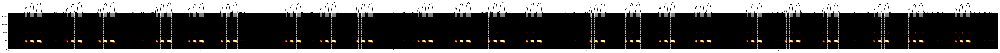

{
  "species_id": "466ssdw",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_466ssdw.wav",
  "samplerate_hz": 44100,
  "length_s": 5.127800453514739,
  "indvs": {
    "466ssdw": {
      "syllables": {
        "start_times": [0.089, 0.114, 0.148, 0.305, 0.326, 0.36, 0.47, 0.495, 0.529, 0.767, 0.791, 0.825, 0.937, 0.96, 0.992, 1.104, 1.133, 1.167, 1.441, 1.464, 1.497, 1.621, 1.646, 1.679, 1.809, 1.834, 1.869, 2.127, 2.15, 2.182, 2.321, 2.344, 2.378, 2.494, 2.519, 2.554, 2.689, 2.712, 2.746, 3.02, 3.044, 3.076, 3.205, 3.227, 3.258, 3.38, 3.406, 3.438, 3.567, 3.593, 3.627, 3.835, 3.858, 3.89, 4.033, 4.056, 4.089, 4.23, 4.253, 4.287, 4.494, 4.516, 4.55, 4.674, 4.696, 4.728, 4.917, 4.94, 4.972],
        "end_times": [0.099, 0.133, 0.173, 0.31, 0.344, 0.384, 0.48, 0.514, 0.553, 0.776, 0.809, 0.848, 0.944, 0.977, 1.015, 1.116, 1.151, 1.19, 1.449, 1.481, 1.52, 1.63, 1.664, 1.702, 1.819, 1.853, 1.893, 2.135, 2.168, 2.205, 2.329, 2.362, 2.4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4140000000000006
longest vocalization 0.015000000000000124


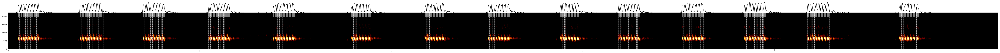

{
  "species_id": "467ssdw",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_467ssdw.wav",
  "samplerate_hz": 44100,
  "length_s": 5.155283446712018,
  "indvs": {
    "467ssdw": {
      "syllables": {
        "start_times": [0.051, 0.065, 0.076, 0.09, 0.105, 0.12, 0.135, 0.151, 0.374, 0.386, 0.399, 0.413, 0.428, 0.443, 0.458, 0.475, 0.494, 0.703, 0.715, 0.728, 0.743, 0.757, 0.772, 0.788, 0.805, 1.046, 1.056, 1.069, 1.084, 1.098, 1.112, 1.128, 1.143, 1.383, 1.392, 1.405, 1.42, 1.434, 1.449, 1.466, 1.482, 1.791, 1.803, 1.817, 1.832, 1.847, 1.862, 1.877, 2.176, 2.188, 2.203, 2.218, 2.231, 2.247, 2.263, 2.505, 2.517, 2.529, 2.545, 2.558, 2.572, 2.588, 2.604, 2.881, 2.893, 2.908, 2.922, 2.937, 2.952, 2.968, 3.186, 3.196, 3.21, 3.223, 3.238, 3.252, 3.268, 3.284, 3.517, 3.529, 3.542, 3.556, 3.571, 3.585, 3.602, 3.617, 3.842, 3.854, 3.867, 3.882, 3.896, 3.911, 3.927, 3.942, 4.172, 4.186, 4.198, 4.212, 4.226, 4.241, 4.257, 4.273, 4.651, 4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3200000000000003
longest vocalization 0.015000000000000568


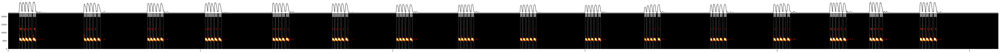

{
  "species_id": "468ssdw",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_468ssdw.wav",
  "samplerate_hz": 44100,
  "length_s": 5.137596371882086,
  "indvs": {
    "468ssdw": {
      "syllables": {
        "start_times": [0.058, 0.074, 0.09, 0.108, 0.129, 0.394, 0.41, 0.426, 0.444, 0.465, 0.725, 0.739, 0.755, 0.773, 0.793, 1.025, 1.04, 1.056, 1.074, 1.095, 1.376, 1.391, 1.408, 1.425, 1.446, 1.686, 1.7, 1.716, 1.734, 1.755, 2.02, 2.035, 2.051, 2.069, 2.09, 2.342, 2.356, 2.373, 2.39, 2.409, 2.664, 2.678, 2.695, 2.714, 2.733, 3.002, 3.016, 3.033, 3.051, 3.07, 3.31, 3.323, 3.34, 3.357, 3.379, 3.653, 3.668, 3.684, 3.702, 3.723, 3.982, 3.998, 4.014, 4.032, 4.053, 4.275, 4.29, 4.306, 4.324, 4.344, 4.481, 4.496, 4.513, 4.534, 4.743, 4.758, 4.775, 4.794, 4.815],
        "end_times": [0.071, 0.088, 0.105, 0.122, 0.144, 0.406, 0.424, 0.44, 0.458, 0.479, 0.737, 0.752, 0.769, 0.787, 0.807, 1.037, 1.053, 1.07, 1.088, 1.109, 1.388, 1.405, 1.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.16800000000000015
longest vocalization 0.015000000000000124
Current min_level_db: -40
longest silence 0.1689999999999996
longest vocalization 0.014000000000000234
Current min_level_db: -35
longest silence 0.16999999999999993
longest vocalization 0.013000000000000345
Current min_level_db: -30
longest silence 0.1850000000000005
longest vocalization 0.01100000000000012
Current min_level_db: -25
longest silence 0.3730000000000002
longest vocalization 0.009000000000000008


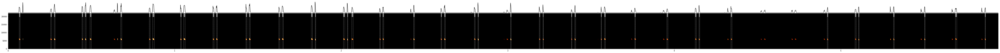

{
  "species_id": "470ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_470ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.930521541950113,
  "indvs": {
    "470ss": {
      "syllables": {
        "start_times": [0.066, 0.255, 0.276, 0.443, 0.462, 0.491, 0.676, 0.847, 0.868, 1.035, 1.054, 1.23, 1.25, 1.428, 1.447, 1.625, 1.645, 1.82, 1.843, 2.013, 2.036, 2.063, 2.231, 2.249, 2.434, 2.599, 2.619, 2.799, 2.82, 3.016, 3.189, 3.211, 3.382, 3.402, 3.56, 3.58, 3.762, 3.955, 4.126, 4.148, 4.34, 4.918, 5.086, 5.106, 5.316, 5.502, 5.688, 5.865],
        "end_times": [0.072, 0.261, 0.282, 0.449, 0.468, 0.499, 0.682, 0.853, 0.877, 1.04, 1.063, 1.236, 1.256, 1.433, 1.454, 1.631, 1.653, 1.828, 1.847, 2.021, 2.04, 2.071, 2.235, 2.255, 2.44, 2.603, 2.625, 2.805, 2.825, 3.021, 3.193, 3.214, 3.385, 3.407, 3.563, 3.587, 3.767, 3.961, 4.132, 4.152, 4.346, 4.923, 5.092, 5.11, 5.321, 5.506, 5.696, 5.869]
      }
    }
  }
}
475scl


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4740000000000002
longest vocalization 0.020999999999999908


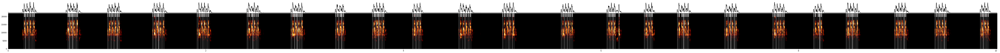

{
  "species_id": "475scl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_475scl.wav",
  "samplerate_hz": 44100,
  "length_s": 9.988185941043083,
  "indvs": {
    "475scl": {
      "syllables": {
        "start_times": [0.161, 0.174, 0.188, 0.208, 0.219, 0.24, 0.256, 0.601, 0.616, 0.62, 0.63, 0.647, 0.653, 0.661, 0.68, 0.695, 1.006, 1.02, 1.04, 1.05, 1.069, 1.08, 1.101, 1.106, 1.117, 1.461, 1.476, 1.493, 1.503, 1.519, 1.523, 1.534, 1.553, 1.568, 1.912, 1.927, 1.955, 1.971, 1.985, 2.006, 2.022, 2.418, 2.432, 2.459, 2.475, 2.479, 2.49, 2.511, 2.524, 2.863, 2.877, 2.896, 2.906, 2.922, 2.927, 2.937, 2.954, 2.97, 3.312, 3.326, 3.344, 3.355, 3.372, 3.376, 3.387, 3.686, 3.7, 3.715, 3.729, 3.745, 3.751, 3.759, 3.778, 3.794, 4.093, 4.108, 4.126, 4.136, 4.153, 4.168, 4.561, 4.576, 4.603, 4.623, 4.632, 4.656, 4.672, 5.003, 5.018, 5.045, 5.065, 5.076, 5.1, 5.11, 5.597, 5.611, 5.629, 5.64, 5.659, 5.668, 5.686, 5.704, 6.061, 6.075, 6.092, 6.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.1800000000000006
longest vocalization 0.015000000000000568
Current min_level_db: -40
longest silence 0.36799999999999944
longest vocalization 0.01100000000000012


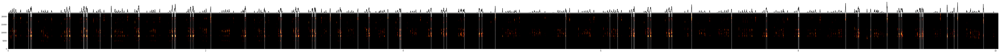

{
  "species_id": "475sct",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_475sct.wav",
  "samplerate_hz": 44100,
  "length_s": 10.003129251700681,
  "indvs": {
    "475sct": {
      "syllables": {
        "start_times": [0.058, 0.205, 0.225, 0.233, 0.592, 0.617, 0.762, 0.766, 0.788, 0.801, 0.93, 1.043, 1.319, 1.659, 1.685, 1.69, 1.844, 1.869, 2.05, 2.396, 2.595, 2.755, 2.763, 2.908, 2.912, 2.933, 3.077, 3.102, 3.113, 3.26, 3.362, 3.541, 3.65, 3.844, 3.962, 3.968, 3.976, 4.28, 4.41, 4.437, 4.618, 4.767, 4.797, 4.931, 5.644, 6.092, 6.17, 6.31, 6.329, 6.339, 6.477, 6.5, 6.689, 6.717, 6.919, 7.324, 7.675, 7.999, 8.005, 8.479, 8.605, 8.734, 8.899, 9.019, 9.04, 9.231, 9.241, 9.253, 9.266, 9.508, 9.577, 9.613, 9.875],
        "end_times": [0.061, 0.208, 0.23, 0.239, 0.598, 0.627, 0.765, 0.772, 0.797, 0.804, 0.933, 1.047, 1.329, 1.666, 1.688, 1.697, 1.851, 1.879, 2.054, 2.407, 2.598, 2.762, 2.767, 2.911, 2.919, 2.941, 3.083, 3.108, 3.1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.08199999999999985
longest vocalization 0.010999999999999996
Current min_level_db: -40
longest silence 0.10499999999999998
longest vocalization 0.009000000000000008
Current min_level_db: -35
longest silence 0.13600000000000012
longest vocalization 0.008999999999999994
Current min_level_db: -30
longest silence 0.2589999999999999
longest vocalization 0.008000000000000007


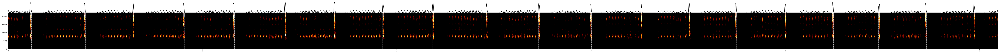

{
  "species_id": "479scdg",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_479scdg.wav",
  "samplerate_hz": 44100,
  "length_s": 5.085170068027211,
  "indvs": {
    "479scdg": {
      "syllables": {
        "start_times": [0.112, 0.391, 0.642, 0.9, 1.158, 1.423, 1.677, 1.928, 2.185, 2.461, 2.73, 2.996, 3.258, 3.504, 3.743, 3.998, 4.242, 4.481, 4.72, 4.971],
        "end_times": [0.12, 0.398, 0.647, 0.908, 1.165, 1.431, 1.684, 1.935, 2.191, 2.467, 2.737, 3.003, 3.264, 3.51, 3.75, 4.005, 4.249, 4.488, 4.727, 4.977]
      }
    }
  }
}
479ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.14400000000000013
longest vocalization 0.008000000000000007
Current min_level_db: -40
longest silence 0.14400000000000013
longest vocalization 0.007000000000000561
Current min_level_db: -35
longest silence 0.14399999999999924
longest vocalization 0.007000000000000117
Current min_level_db: -30
longest silence 0.14499999999999957
longest vocalization 0.007000000000000117
Current min_level_db: -25
longest silence 0.14499999999999957
longest vocalization 0.006000000000000227
Current min_level_db: -20
longest silence 0.167
longest vocalization 0.005000000000000782
Current min_level_db: -15
longest silence 0.475
longest vocalization 0.0040000000000000036


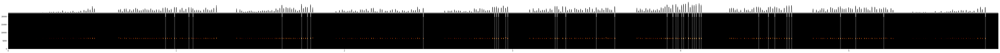

{
  "species_id": "479ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_479ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.874648526077097,
  "indvs": {
    "479ss": {
      "syllables": {
        "start_times": [0.934, 0.988, 1.074, 1.098, 1.628, 1.744, 1.779, 1.798, 2.468, 2.892, 2.904, 2.915, 2.958, 2.97, 3.252, 3.264, 3.315, 3.497, 3.607, 3.918, 3.952, 3.971, 3.982, 4.005, 4.016, 4.045, 4.068, 4.079, 4.091, 4.109, 4.121, 4.463, 4.521, 4.559, 4.63, 4.644, 4.659, 4.949, 5.04, 5.207, 5.811],
        "end_times": [0.937, 0.991, 1.077, 1.101, 1.631, 1.747, 1.782, 1.801, 2.471, 2.895, 2.907, 2.918, 2.961, 2.973, 3.255, 3.267, 3.318, 3.5, 3.61, 3.921, 3.956, 3.974, 3.985, 4.008, 4.019, 4.048, 4.071, 4.082, 4.094, 4.112, 4.124, 4.466, 4.524, 4.562, 4.633, 4.647, 4.662, 4.952, 5.043, 5.21, 5.814]
      }
    }
  }
}
480ssdw1


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.45899999999999963
longest vocalization 0.015000000000000013


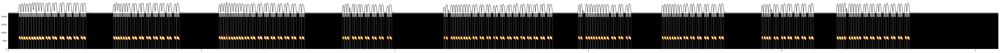

{
  "species_id": "480ssdw1",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_480ssdw1.wav",
  "samplerate_hz": 44100,
  "length_s": 5.1066666666666665,
  "indvs": {
    "480ssdw1": {
      "syllables": {
        "start_times": [0.055, 0.068, 0.08, 0.093, 0.106, 0.12, 0.133, 0.147, 0.161, 0.174, 0.193, 0.207, 0.227, 0.24, 0.266, 0.278, 0.302, 0.315, 0.338, 0.351, 0.375, 0.389, 0.543, 0.555, 0.568, 0.581, 0.594, 0.606, 0.619, 0.641, 0.654, 0.676, 0.689, 0.713, 0.726, 0.749, 0.762, 0.783, 0.796, 0.82, 0.833, 0.858, 0.872, 1.09, 1.101, 1.114, 1.127, 1.139, 1.153, 1.165, 1.179, 1.193, 1.206, 1.222, 1.235, 1.253, 1.266, 1.29, 1.302, 1.324, 1.336, 1.357, 1.37, 1.393, 1.406, 1.428, 1.441, 1.464, 1.477, 1.505, 1.519, 1.728, 1.74, 1.753, 1.766, 1.779, 1.791, 1.809, 1.822, 1.844, 1.857, 1.881, 1.894, 1.917, 1.93, 1.958, 1.971, 2.252, 2.263, 2.288, 2.301, 2.314, 2.326, 2.339, 2.354, 2.366, 2.38, 2.401, 2.414, 2.437, 2.45, 2.472, 2.485, 2.50

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4820000000000002
longest vocalization 0.013000000000000345


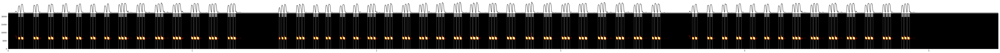

{
  "species_id": "480ssdw2",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_480ssdw2.wav",
  "samplerate_hz": 44100,
  "length_s": 5.363809523809524,
  "indvs": {
    "480ssdw2": {
      "syllables": {
        "start_times": [0.055, 0.071, 0.138, 0.153, 0.218, 0.233, 0.295, 0.31, 0.37, 0.385, 0.447, 0.462, 0.523, 0.538, 0.6, 0.615, 0.632, 0.7, 0.714, 0.73, 0.799, 0.813, 0.831, 0.895, 0.91, 0.927, 0.994, 1.009, 1.025, 1.091, 1.106, 1.122, 1.193, 1.208, 1.224, 1.471, 1.485, 1.501, 1.566, 1.581, 1.598, 1.658, 1.672, 1.725, 1.74, 1.802, 1.817, 1.875, 1.891, 1.952, 1.967, 1.984, 2.045, 2.06, 2.077, 2.141, 2.155, 2.172, 2.233, 2.248, 2.265, 2.326, 2.341, 2.357, 2.421, 2.436, 2.452, 2.51, 2.525, 2.542, 2.612, 2.627, 2.643, 2.709, 2.724, 2.74, 2.811, 2.826, 2.843, 2.909, 2.923, 2.94, 3.007, 3.021, 3.038, 3.1, 3.115, 3.132, 3.203, 3.219, 3.236, 3.301, 3.315, 3.333, 3.399, 3.413, 3.43, 3.497, 3.512, 3.529, 3.715, 3.73, 3.798, 3.813, 3.87

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3210000000000002
longest vocalization 0.03600000000000003


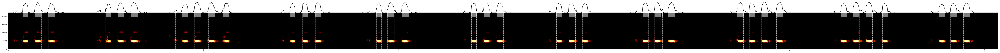

{
  "species_id": "481ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_481ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.058684807256236,
  "indvs": {
    "481ss": {
      "syllables": {
        "start_times": [0.075, 0.136, 0.206, 0.499, 0.561, 0.629, 0.857, 0.89, 0.954, 1.026, 1.099, 1.444, 1.508, 1.573, 1.886, 1.942, 2.016, 2.373, 2.436, 2.503, 2.808, 2.871, 2.941, 3.25, 3.311, 3.351, 3.381, 3.734, 3.796, 3.859, 3.935, 4.266, 4.328, 4.394, 4.478, 4.767, 4.827, 4.893],
        "end_times": [0.103, 0.17, 0.239, 0.527, 0.594, 0.665, 0.861, 0.921, 0.986, 1.061, 1.133, 1.47, 1.535, 1.603, 1.912, 1.978, 2.052, 2.399, 2.467, 2.537, 2.836, 2.906, 2.969, 3.28, 3.342, 3.354, 3.416, 3.766, 3.826, 3.891, 3.968, 4.295, 4.36, 4.427, 4.505, 4.799, 4.859, 4.926]
      }
    }
  }
}
482scdg


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.217
longest vocalization 0.009000000000000341
Current min_level_db: -40
longest silence 0.33999999999999997
longest vocalization 0.009000000000000008


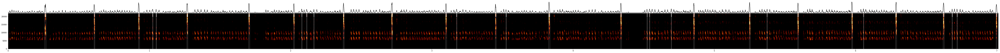

{
  "species_id": "482scdg",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_482scdg.wav",
  "samplerate_hz": 44100,
  "length_s": 6.995011337868481,
  "indvs": {
    "482scdg": {
      "syllables": {
        "start_times": [0.259, 0.608, 0.922, 1.022, 1.047, 1.265, 1.703, 2.021, 2.078, 2.113, 2.164, 2.372, 2.714, 3.098, 3.174, 3.449, 3.525, 3.828, 4.336, 4.523, 4.541, 4.695, 4.853, 5.248, 5.373, 5.59, 5.973, 6.056, 6.284, 6.621, 6.684, 6.718, 6.996],
        "end_times": [0.268, 0.614, 0.93, 1.026, 1.051, 1.272, 1.71, 2.027, 2.081, 2.116, 2.167, 2.379, 2.722, 3.105, 3.178, 3.456, 3.528, 3.836, 4.344, 4.526, 4.544, 4.698, 4.86, 5.255, 5.376, 5.597, 5.98, 6.059, 6.292, 6.628, 6.687, 6.722, 7.003]
      }
    }
  }
}
483ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4869999999999999
longest vocalization 0.049


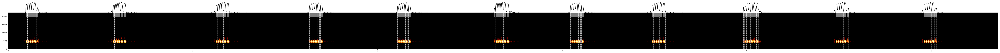

{
  "species_id": "483ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_483ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.350294784580499,
  "indvs": {
    "483ss": {
      "syllables": {
        "start_times": [0.096, 0.105, 0.156, 0.567, 0.576, 0.61, 0.627, 1.126, 1.135, 1.169, 1.186, 1.632, 1.641, 1.675, 1.692, 2.109, 2.118, 2.152, 2.169, 2.633, 2.64, 2.66, 2.683, 2.702, 3.046, 3.055, 3.089, 3.106, 3.488, 3.497, 3.531, 3.548, 3.983, 3.992, 4.001, 4.023, 4.036, 4.053, 4.484, 4.528, 4.545, 4.551, 4.961, 4.971, 5.005, 5.022, 5.028],
        "end_times": [0.104, 0.154, 0.161, 0.575, 0.607, 0.622, 0.639, 1.134, 1.166, 1.18, 1.198, 1.64, 1.672, 1.686, 1.704, 2.117, 2.149, 2.164, 2.181, 2.636, 2.659, 2.682, 2.697, 2.714, 3.054, 3.086, 3.1, 3.118, 3.496, 3.528, 3.542, 3.56, 3.988, 3.999, 4.021, 4.034, 4.049, 4.065, 4.525, 4.54, 4.55, 4.554, 4.97, 5.002, 5.018, 5.027, 5.031]
      }
    }
  }
}
484ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5849999999999997
longest vocalization 0.015000000000000568


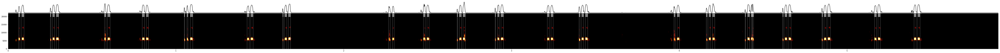

{
  "species_id": "484ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_484ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.886621315192744,
  "indvs": {
    "484ss": {
      "syllables": {
        "start_times": [0.062, 0.081, 0.251, 0.265, 0.287, 0.573, 0.593, 0.799, 0.823, 1.049, 1.065, 1.085, 1.424, 1.446, 1.636, 1.648, 1.67, 2.268, 2.29, 2.475, 2.496, 2.676, 2.689, 2.711, 2.902, 2.917, 2.937, 3.213, 3.235, 3.402, 3.418, 3.44, 3.968, 3.987, 4.161, 4.176, 4.198, 4.392, 4.407, 4.428, 4.436, 4.616, 4.629, 4.652, 4.85, 4.863, 4.885, 5.163, 5.184, 5.399, 5.421],
        "end_times": [0.07, 0.094, 0.255, 0.276, 0.301, 0.583, 0.607, 0.812, 0.836, 1.053, 1.072, 1.1, 1.436, 1.46, 1.639, 1.661, 1.683, 2.277, 2.3, 2.486, 2.509, 2.679, 2.701, 2.724, 2.905, 2.927, 2.952, 3.225, 3.248, 3.409, 3.43, 3.454, 3.976, 4.001, 4.167, 4.187, 4.211, 4.395, 4.419, 4.434, 4.443, 4.62, 4.642, 4.666, 4.854, 4.876, 4.9, 5.175, 5.198, 5.412, 5.435]
 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.0710000000000006
longest vocalization 0.0259999999999998


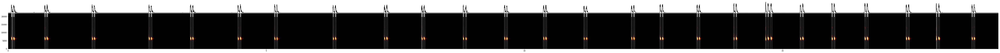

{
  "species_id": "487sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_487sl.wav",
  "samplerate_hz": 44100,
  "length_s": 19.130725623582766,
  "indvs": {
    "487sl": {
      "syllables": {
        "start_times": [0.06, 0.079, 0.101, 0.704, 0.745, 1.622, 1.662, 2.723, 2.765, 3.526, 3.568, 4.448, 4.49, 5.156, 5.199, 6.288, 6.33, 7.283, 7.324, 8.005, 8.012, 8.047, 8.81, 8.855, 9.609, 9.651, 10.364, 10.406, 11.148, 11.191, 12.069, 12.111, 12.623, 12.666, 13.338, 13.378, 14.052, 14.093, 14.668, 14.709, 14.767, 15.339, 15.38, 15.95, 15.993, 16.587, 16.631, 17.389, 17.432, 17.973, 17.983, 18.014, 18.662, 18.703],
        "end_times": [0.076, 0.083, 0.123, 0.721, 0.766, 1.638, 1.682, 2.739, 2.784, 3.544, 3.586, 4.465, 4.511, 5.173, 5.217, 6.305, 6.351, 7.3, 7.347, 8.011, 8.024, 8.069, 8.824, 8.877, 9.627, 9.67, 10.382, 10.428, 11.163, 11.213, 12.085, 12.13, 12.639, 12.683, 13.354, 13.396, 14.062, 14.112, 14.68, 14.733, 14.793, 15.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.7670000000000001
longest vocalization 0.025000000000000355


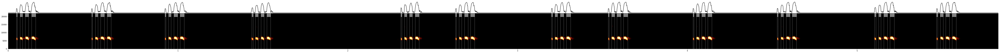

{
  "species_id": "488ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_488ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.816961451247166,
  "indvs": {
    "488ss": {
      "syllables": {
        "start_times": [0.049, 0.07, 0.101, 0.138, 0.492, 0.513, 0.545, 0.583, 0.924, 0.945, 0.976, 1.013, 1.435, 1.456, 1.489, 1.524, 2.313, 2.334, 2.364, 2.397, 2.635, 2.656, 2.688, 2.724, 3.2, 3.221, 3.252, 3.288, 3.534, 3.554, 3.586, 3.624, 4.034, 4.054, 4.085, 4.121, 4.529, 4.551, 4.583, 4.618, 5.103, 5.127, 5.157, 5.194, 5.468, 5.49, 5.522, 5.56],
        "end_times": [0.054, 0.085, 0.121, 0.162, 0.497, 0.529, 0.567, 0.606, 0.929, 0.96, 0.998, 1.037, 1.443, 1.473, 1.507, 1.546, 2.319, 2.348, 2.381, 2.42, 2.641, 2.671, 2.709, 2.748, 3.206, 3.236, 3.272, 3.313, 3.54, 3.572, 3.609, 3.649, 4.039, 4.07, 4.106, 4.145, 4.535, 4.566, 4.604, 4.643, 5.111, 5.141, 5.179, 5.219, 5.475, 5.507, 5.544, 5.584]
      }
    }
  }
}
489ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.0199999999999998
longest vocalization 0.03000000000000025


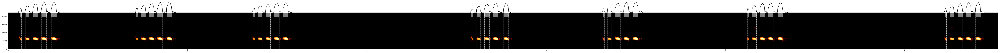

{
  "species_id": "489ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_489ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.508934240362811,
  "indvs": {
    "489ss": {
      "syllables": {
        "start_times": [0.065, 0.097, 0.138, 0.186, 0.241, 0.713, 0.742, 0.786, 0.832, 0.884, 1.366, 1.394, 1.437, 1.483, 1.534, 2.582, 2.586, 2.613, 2.656, 2.705, 2.763, 3.318, 3.343, 3.386, 3.434, 3.485, 4.124, 4.149, 4.193, 4.239, 4.292, 5.225, 5.253, 5.296, 5.343, 5.396],
        "end_times": [0.075, 0.117, 0.165, 0.214, 0.27, 0.724, 0.767, 0.813, 0.861, 0.913, 1.376, 1.417, 1.463, 1.512, 1.562, 2.585, 2.593, 2.634, 2.684, 2.733, 2.791, 3.325, 3.364, 3.414, 3.462, 3.514, 4.131, 4.173, 4.22, 4.267, 4.322, 5.233, 5.275, 5.323, 5.371, 5.424]
      }
    }
  }
}
491srds


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5000000000000004
longest vocalization 0.008999999999999897


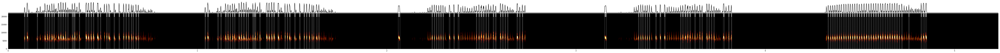

{
  "species_id": "491srds",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_491srds.wav",
  "samplerate_hz": 44100,
  "length_s": 5.21891156462585,
  "indvs": {
    "491srds": {
      "syllables": {
        "start_times": [0.086, 0.099, 0.153, 0.193, 0.206, 0.218, 0.23, 0.241, 0.264, 0.277, 0.289, 0.302, 0.314, 0.338, 0.345, 0.351, 0.375, 0.41, 0.423, 0.437, 0.449, 0.471, 0.487, 0.52, 0.531, 0.559, 0.585, 0.609, 0.622, 0.635, 0.65, 0.659, 0.674, 0.687, 1.04, 1.053, 1.107, 1.123, 1.147, 1.16, 1.172, 1.184, 1.195, 1.218, 1.231, 1.243, 1.257, 1.268, 1.292, 1.299, 1.305, 1.329, 1.364, 1.377, 1.391, 1.403, 1.425, 1.462, 1.474, 1.485, 1.513, 1.539, 1.563, 1.576, 1.589, 1.604, 1.613, 1.628, 1.641, 2.061, 2.239, 2.251, 2.262, 2.274, 2.285, 2.297, 2.33, 2.354, 2.377, 2.473, 2.486, 2.498, 2.51, 2.524, 2.537, 2.562, 2.575, 2.6, 2.612, 2.625, 2.638, 2.688, 2.702, 2.716, 3.152, 3.33, 3.341, 3.352, 3.365, 3.376, 3.387, 3.421, 3.444, 3.467, 3.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.007000000000000561
longest vocalization 0.008000000000000007
Current min_level_db: -40
longest silence 0.008000000000000007
longest vocalization 0.008000000000000007
Current min_level_db: -35
longest silence 0.008000000000000007
longest vocalization 0.007000000000000561
Current min_level_db: -30
longest silence 0.008000000000000007
longest vocalization 0.006999999999999673
Current min_level_db: -25
longest silence 0.009000000000000008
longest vocalization 0.006000000000000227
Current min_level_db: -20
longest silence 0.010000000000000009
longest vocalization 0.005000000000000782
Current min_level_db: -15
longest silence 0.01200000000000001
longest vocalization 0.004000000000000448
Current min_level_db: -10
492ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.009999999999999787
longest vocalization 0.007000000000000006
Current min_level_db: -40
longest silence 0.009000000000000341
longest vocalization 0.007000000000000006
Current min_level_db: -35
longest silence 0.009000000000000341
longest vocalization 0.006000000000000005
Current min_level_db: -30
longest silence 0.010000000000000675
longest vocalization 0.006000000000000005
Current min_level_db: -25
longest silence 0.02800000000000047
longest vocalization 0.0030000000000001137
Current min_level_db: -20
longest silence 0.9410000000000007
longest vocalization 0.002000000000000224


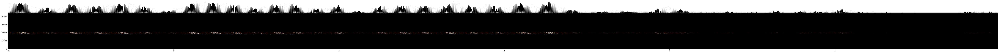

{
  "species_id": "492ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_492ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.973560090702948,
  "indvs": {
    "492ss": {
      "syllables": {
        "start_times": [],
        "end_times": []
      }
    }
  }
}
499sl


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.6319999999999997
longest vocalization 0.017000000000000348


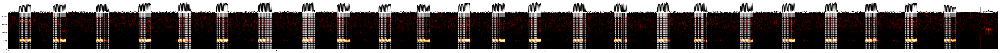

{
  "species_id": "499sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_499sl.wav",
  "samplerate_hz": 44100,
  "length_s": 18.390226757369614,
  "indvs": {
    "499sl": {
      "syllables": {
        "start_times": [0.198, 0.211, 0.225, 0.239, 0.253, 0.268, 0.282, 0.297, 0.312, 0.328, 0.343, 0.359, 0.375, 0.393, 0.414, 0.843, 0.856, 0.87, 0.884, 0.899, 0.913, 0.928, 0.942, 0.958, 0.972, 0.988, 1.003, 1.021, 1.039, 1.06, 1.637, 1.649, 1.663, 1.677, 1.691, 1.704, 1.719, 1.733, 1.747, 1.762, 1.777, 1.794, 1.813, 1.833, 1.854, 2.429, 2.442, 2.456, 2.47, 2.483, 2.497, 2.511, 2.525, 2.539, 2.554, 2.57, 2.586, 2.605, 2.625, 2.646, 3.165, 3.178, 3.191, 3.205, 3.219, 3.233, 3.247, 3.261, 3.275, 3.289, 3.304, 3.321, 3.339, 3.359, 3.378, 3.868, 3.881, 3.895, 3.908, 3.923, 3.936, 3.95, 3.965, 3.979, 3.994, 4.009, 4.024, 4.042, 4.06, 4.081, 4.653, 4.666, 4.679, 4.693, 4.708, 4.722, 4.736, 4.75, 4.765, 4.779, 4.794, 4.81, 4.827, 4.846, 4.8

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2290000000000001
longest vocalization 0.016000000000000014
Current min_level_db: -40
longest silence 0.23099999999999987
longest vocalization 0.016000000000000014
Current min_level_db: -35
longest silence 0.2490000000000001
longest vocalization 0.015000000000000124
Current min_level_db: -30
longest silence 0.2520000000000002
longest vocalization 0.013000000000000345


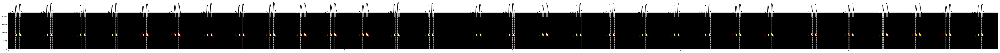

{
  "species_id": "501ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_501ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.875147392290249,
  "indvs": {
    "501ss": {
      "syllables": {
        "start_times": [0.044, 0.067, 0.229, 0.252, 0.428, 0.45, 0.616, 0.639, 0.8, 0.822, 0.99, 1.012, 1.182, 1.204, 1.371, 1.394, 1.555, 1.578, 1.738, 1.761, 1.917, 1.94, 2.108, 2.13, 2.294, 2.316, 2.497, 2.519, 2.782, 2.804, 2.978, 3.0, 3.177, 3.2, 3.377, 3.4, 3.574, 3.597, 3.769, 3.791, 3.961, 3.983, 4.145, 4.167, 4.327, 4.35, 4.518, 4.54, 4.777, 4.799, 4.998, 5.02, 5.2, 5.222, 5.396, 5.419, 5.576, 5.599, 5.768, 5.789],
        "end_times": [0.053, 0.077, 0.237, 0.263, 0.435, 0.46, 0.624, 0.649, 0.807, 0.833, 0.997, 1.021, 1.189, 1.214, 1.38, 1.404, 1.564, 1.589, 1.747, 1.772, 1.925, 1.951, 2.116, 2.141, 2.303, 2.329, 2.506, 2.53, 2.789, 2.814, 2.986, 3.011, 3.186, 3.211, 3.385, 3.409, 3.582, 3.607, 3.776, 3.801, 3.968, 3.992, 4.152, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.23300000000000054
longest vocalization 0.008000000000000007
Current min_level_db: -40
longest silence 0.23300000000000054
longest vocalization 0.007000000000000561
Current min_level_db: -35
longest silence 0.2340000000000002
longest vocalization 0.007000000000000117
Current min_level_db: -30
longest silence 0.2340000000000002
longest vocalization 0.006000000000000227
Current min_level_db: -25
longest silence 0.2340000000000002
longest vocalization 0.005999999999999339
Current min_level_db: -20
longest silence 0.23499999999999943
longest vocalization 0.0050000000000001155
Current min_level_db: -15
longest silence 0.2959999999999994
longest vocalization 0.004000000000000448


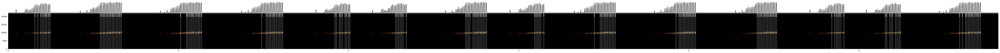

{
  "species_id": "521ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_521ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.804988662131519,
  "indvs": {
    "521ss": {
      "syllables": {
        "start_times": [0.156, 0.173, 0.19, 0.199, 0.208, 0.216, 0.225, 0.235, 0.243, 0.541, 0.549, 0.558, 0.566, 0.575, 0.583, 0.592, 0.6, 0.609, 0.618, 0.626, 0.636, 0.644, 0.653, 0.663, 1.012, 1.046, 1.054, 1.063, 1.072, 1.08, 1.089, 1.098, 1.107, 1.116, 1.125, 1.134, 1.489, 1.515, 1.523, 1.532, 1.54, 1.549, 1.557, 1.566, 1.575, 1.584, 1.593, 1.602, 1.611, 1.919, 1.927, 1.944, 1.953, 1.962, 1.979, 1.988, 1.998, 2.006, 2.276, 2.284, 2.293, 2.302, 2.311, 2.32, 2.338, 2.688, 2.696, 2.705, 2.713, 2.73, 2.738, 2.747, 2.756, 2.765, 2.773, 2.783, 2.791, 2.8, 2.81, 3.093, 3.102, 3.111, 3.119, 3.129, 3.147, 3.444, 3.478, 3.486, 3.495, 3.504, 3.512, 3.521, 3.53, 3.539, 3.548, 3.557, 3.566, 3.924, 3.941, 3.949, 3.958, 3.966, 3.975, 3.983, 3.992, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.46299999999999986
longest vocalization 0.006000000000000227


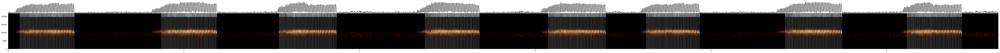

{
  "species_id": "521ss2",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_521ss2.wav",
  "samplerate_hz": 44100,
  "length_s": 5.622721088435374,
  "indvs": {
    "521ss2": {
      "syllables": {
        "start_times": [0.067, 0.074, 0.081, 0.089, 0.096, 0.103, 0.111, 0.118, 0.125, 0.133, 0.141, 0.148, 0.156, 0.163, 0.171, 0.179, 0.187, 0.195, 0.203, 0.211, 0.219, 0.227, 0.235, 0.243, 0.251, 0.259, 0.267, 0.276, 0.284, 0.292, 0.301, 0.309, 0.318, 0.326, 0.335, 0.344, 0.352, 0.361, 0.371, 0.873, 0.88, 0.888, 0.895, 0.902, 0.909, 0.916, 0.924, 0.932, 0.94, 0.947, 0.955, 0.963, 0.971, 0.979, 0.987, 0.995, 1.003, 1.011, 1.019, 1.027, 1.035, 1.043, 1.052, 1.06, 1.068, 1.077, 1.085, 1.094, 1.102, 1.111, 1.12, 1.128, 1.137, 1.146, 1.155, 1.163, 1.172, 1.181, 1.544, 1.551, 1.558, 1.565, 1.572, 1.58, 1.587, 1.594, 1.601, 1.609, 1.616, 1.623, 1.631, 1.639, 1.647, 1.654, 1.662, 1.67, 1.678, 1.686, 1.694, 1.701, 1.71, 1.718, 1.726, 1.734, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.14100000000000001
longest vocalization 0.017000000000000348
Current min_level_db: -40
longest silence 0.14199999999999946
longest vocalization 0.016000000000000014
Current min_level_db: -35
longest silence 0.1419999999999999
longest vocalization 0.016000000000000014
Current min_level_db: -30
longest silence 0.14400000000000013
longest vocalization 0.015000000000000124
Current min_level_db: -25
longest silence 0.15799999999999992
longest vocalization 0.013000000000000123
Current min_level_db: -20
longest silence 0.16900000000000048
longest vocalization 0.01100000000000012
Current min_level_db: -15
longest silence 0.44700000000000006
longest vocalization 0.009000000000000119


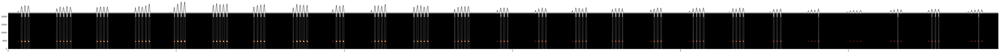

{
  "species_id": "551ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_551ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.877460317460318,
  "indvs": {
    "551ss": {
      "syllables": {
        "start_times": [0.077, 0.097, 0.117, 0.288, 0.307, 0.327, 0.347, 0.368, 0.526, 0.546, 0.567, 0.588, 0.756, 0.775, 0.795, 0.816, 0.836, 0.987, 1.005, 1.025, 1.046, 1.218, 1.237, 1.257, 1.277, 1.298, 1.46, 1.48, 1.5, 1.521, 1.695, 1.714, 1.734, 1.754, 1.775, 1.95, 1.97, 1.99, 2.179, 2.199, 2.22, 2.24, 2.412, 2.432, 2.453, 2.473, 2.493, 2.656, 2.674, 2.695, 2.715, 2.735, 2.929, 2.948, 2.969, 3.156, 3.176, 3.196, 3.376, 3.396, 3.416, 3.437, 3.595, 3.612, 3.633, 3.653, 3.842, 3.861, 3.882, 4.074, 4.094, 4.114, 4.135, 4.311, 4.33, 4.351, 4.371, 4.553, 4.573, 4.594, 4.821, 5.292, 5.495, 5.516, 5.535, 5.773],
        "end_times": [0.084, 0.105, 0.125, 0.293, 0.314, 0.334, 0.355, 0.375, 0.533, 0.554, 0.574, 0.594, 0.761, 0.782, 0.802, 0.82

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.4210000000000003
longest vocalization 0.15600000000000014
Current min_level_db: -40
longest silence 1.4240000000000004
longest vocalization 0.06800000000000006
Current min_level_db: -35
longest silence 1.4290000000000003
longest vocalization 0.04400000000000004


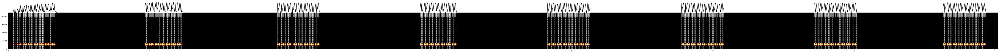

{
  "species_id": "575sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_575sl.wav",
  "samplerate_hz": 44100,
  "length_s": 14.019138321995465,
  "indvs": {
    "575sl": {
      "syllables": {
        "start_times": [0.073, 0.094, 0.131, 0.151, 0.173, 0.206, 0.222, 0.228, 0.245, 0.252, 0.286, 0.299, 0.308, 0.324, 0.33, 0.365, 0.379, 0.387, 0.402, 0.408, 0.443, 0.459, 0.465, 0.482, 0.488, 0.521, 0.567, 0.6, 0.624, 1.944, 1.966, 2.002, 2.023, 2.045, 2.081, 2.102, 2.16, 2.181, 2.204, 2.239, 2.261, 2.284, 2.318, 2.34, 2.364, 2.382, 2.398, 2.421, 2.444, 3.822, 3.844, 3.879, 3.901, 3.923, 3.958, 3.98, 4.003, 4.038, 4.06, 4.082, 4.117, 4.139, 4.162, 4.196, 4.218, 4.241, 4.276, 4.297, 4.32, 4.355, 4.378, 4.4, 5.844, 5.866, 5.902, 5.924, 5.947, 5.98, 6.002, 6.024, 6.06, 6.081, 6.104, 6.14, 6.162, 6.185, 6.219, 6.242, 6.264, 6.299, 6.322, 6.344, 7.655, 7.677, 7.712, 7.734, 7.756, 7.791, 7.813, 7.835, 7.871, 7.893, 7.915, 7.95, 7.972, 7.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.770999999999999
longest vocalization 0.0129999999999999


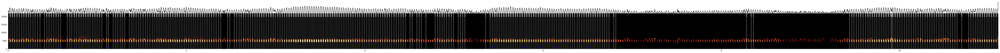

{
  "species_id": "577sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_577sl.wav",
  "samplerate_hz": 44100,
  "length_s": 11.079365079365079,
  "indvs": {
    "577sl": {
      "syllables": {
        "start_times": [0.017, 0.042, 0.068, 0.095, 0.12, 0.147, 0.171, 0.198, 0.225, 0.25, 0.277, 0.3, 0.327, 0.352, 0.404, 0.429, 0.454, 0.48, 0.507, 0.531, 0.559, 0.584, 0.66, 0.687, 0.71, 0.736, 0.763, 0.789, 0.814, 0.839, 0.865, 0.891, 0.915, 0.943, 0.968, 0.994, 1.019, 1.047, 1.101, 1.122, 1.175, 1.201, 1.225, 1.253, 1.276, 1.302, 1.355, 1.381, 1.404, 1.432, 1.462, 1.483, 1.51, 1.536, 1.561, 1.587, 1.613, 1.637, 1.663, 1.688, 1.712, 1.738, 1.765, 1.791, 1.815, 1.842, 1.867, 1.892, 1.919, 1.944, 1.97, 1.995, 2.021, 2.047, 2.072, 2.097, 2.123, 2.15, 2.174, 2.201, 2.227, 2.253, 2.278, 2.303, 2.33, 2.356, 2.381, 2.458, 2.484, 2.535, 2.56, 2.588, 2.61, 2.638, 2.664, 2.689, 2.714, 2.74, 2.764, 2.789, 2.814, 2.839, 2.865, 2.89, 2.917, 2.9

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.029000000000000026
longest vocalization 0.013000000000000789
Current min_level_db: -40
longest silence 0.030000000000000027
longest vocalization 0.01100000000000012
Current min_level_db: -35
longest silence 0.03200000000000003
longest vocalization 0.010000000000000675
Current min_level_db: -30
longest silence 0.03200000000000003
longest vocalization 0.010000000000000675
Current min_level_db: -25
longest silence 0.03200000000000003
longest vocalization 0.010000000000000231
Current min_level_db: -20
longest silence 0.03200000000000003
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.054
longest vocalization 0.007000000000000561
Current min_level_db: -10
582ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.0129999999999999
longest vocalization 0.014000000000000234
Current min_level_db: -40
longest silence 0.0129999999999999
longest vocalization 0.014000000000000234
Current min_level_db: -35
longest silence 0.0129999999999999
longest vocalization 0.014000000000000234
Current min_level_db: -30
longest silence 0.014000000000000234
longest vocalization 0.013000000000000345
Current min_level_db: -25
longest silence 0.014000000000000234
longest vocalization 0.012000000000000455
Current min_level_db: -20
longest silence 0.019000000000000128
longest vocalization 0.01100000000000012
Current min_level_db: -15
longest silence 0.1679999999999997
longest vocalization 0.008000000000000007
Current min_level_db: -10
583ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 6.0840000000000005
longest vocalization 0.002


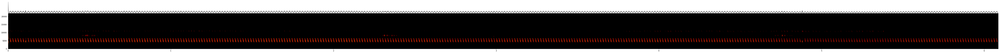

{
  "species_id": "583ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_583ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.071655328798186,
  "indvs": {
    "583ss": {
      "syllables": {
        "start_times": [],
        "end_times": []
      }
    }
  }
}
585ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.22999999999999998
longest vocalization 0.10699999999999976
Current min_level_db: -40
longest silence 0.22999999999999998
longest vocalization 0.051000000000000156
Current min_level_db: -35
longest silence 0.23199999999999976
longest vocalization 0.03000000000000025
Current min_level_db: -30
longest silence 0.23399999999999999
longest vocalization 0.017000000000000348
Current min_level_db: -25
longest silence 0.2360000000000002
longest vocalization 0.016000000000000014
Current min_level_db: -20
longest silence 0.2370000000000001
longest vocalization 0.014000000000000234
Current min_level_db: -15
longest silence 0.2549999999999999
longest vocalization 0.011999999999999567


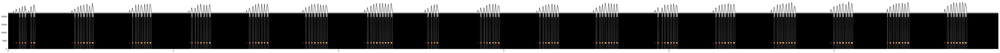

{
  "species_id": "585ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_585ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.979410430839002,
  "indvs": {
    "585ss": {
      "syllables": {
        "start_times": [0.068, 0.084, 0.1, 0.137, 0.153, 0.402, 0.422, 0.438, 0.454, 0.475, 0.491, 0.507, 0.751, 0.77, 0.786, 0.803, 0.824, 0.84, 0.857, 1.11, 1.131, 1.146, 1.163, 1.184, 1.2, 1.216, 1.459, 1.48, 1.496, 1.512, 1.533, 1.549, 1.566, 1.8, 1.82, 1.836, 1.852, 1.873, 1.889, 1.906, 1.923, 2.174, 2.194, 2.21, 2.227, 2.248, 2.264, 2.281, 2.298, 2.316, 2.539, 2.561, 2.577, 2.593, 2.859, 2.88, 2.895, 2.912, 2.933, 2.948, 2.965, 3.216, 3.237, 3.253, 3.269, 3.29, 3.306, 3.323, 3.559, 3.58, 3.595, 3.612, 3.633, 3.649, 3.666, 3.682, 3.932, 3.958, 3.973, 3.99, 4.01, 4.027, 4.043, 4.283, 4.303, 4.319, 4.336, 4.357, 4.373, 4.39, 4.635, 4.655, 4.671, 4.687, 4.709, 4.725, 4.741, 4.758, 4.996, 5.016, 5.032, 5.049, 5.07, 5.086, 5.103, 5.322, 5

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.15600000000000014
longest vocalization 0.028999999999999915
Current min_level_db: -40
longest silence 0.15600000000000014
longest vocalization 0.02400000000000002
Current min_level_db: -35
longest silence 0.15799999999999992
longest vocalization 0.01200000000000001
Current min_level_db: -30
longest silence 0.1750000000000007
longest vocalization 0.009000000000000008
Current min_level_db: -25
longest silence 0.5250000000000004
longest vocalization 0.007000000000000006


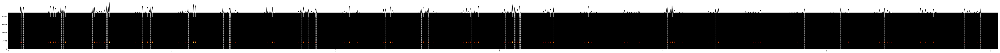

{
  "species_id": "585ssh",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_585ssh.wav",
  "samplerate_hz": 44100,
  "length_s": 6.033560090702948,
  "indvs": {
    "585ssh": {
      "syllables": {
        "start_times": [0.076, 0.093, 0.256, 0.276, 0.288, 0.321, 0.334, 0.347, 0.512, 0.523, 0.601, 0.614, 0.82, 0.849, 0.865, 0.878, 1.098, 1.13, 1.141, 1.311, 1.352, 1.579, 1.613, 1.788, 1.801, 1.832, 1.877, 2.083, 2.303, 2.334, 2.349, 2.521, 2.535, 2.564, 2.823, 2.87, 3.033, 3.077, 3.093, 3.123, 3.31, 3.329, 3.544, 4.023, 4.054, 4.322, 4.865, 5.085, 5.352, 5.651, 5.842, 5.937],
        "end_times": [0.081, 0.097, 0.262, 0.279, 0.292, 0.325, 0.337, 0.353, 0.515, 0.529, 0.606, 0.621, 0.824, 0.854, 0.87, 0.884, 1.101, 1.134, 1.147, 1.315, 1.358, 1.583, 1.616, 1.791, 1.806, 1.835, 1.883, 2.088, 2.306, 2.338, 2.352, 2.525, 2.54, 2.568, 2.829, 2.876, 3.037, 3.082, 3.098, 3.129, 3.316, 3.332, 3.549, 4.028, 4.059, 4.325, 4.868, 5.089, 5.35

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.34699999999999953
longest vocalization 0.02699999999999969


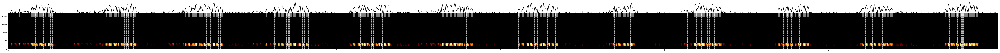

{
  "species_id": "585ssj",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_585ssj.wav",
  "samplerate_hz": 44100,
  "length_s": 6.018956916099773,
  "indvs": {
    "585ssj": {
      "syllables": {
        "start_times": [0.067, 0.139, 0.146, 0.153, 0.159, 0.167, 0.189, 0.216, 0.222, 0.241, 0.261, 0.594, 0.613, 0.643, 0.668, 0.68, 0.687, 0.708, 0.72, 0.744, 0.764, 1.078, 1.098, 1.118, 1.128, 1.165, 1.192, 1.213, 1.233, 1.246, 1.267, 1.293, 1.572, 1.623, 1.643, 1.663, 1.691, 1.699, 1.714, 1.724, 1.738, 1.772, 1.793, 1.815, 2.102, 2.134, 2.152, 2.188, 2.213, 2.242, 2.27, 2.29, 2.313, 2.623, 2.642, 2.651, 2.665, 2.693, 2.717, 2.737, 2.762, 2.776, 2.793, 2.818, 3.11, 3.132, 3.138, 3.161, 3.18, 3.207, 3.218, 3.223, 3.24, 3.258, 3.286, 3.313, 3.335, 3.687, 3.695, 3.702, 3.717, 3.747, 3.76, 3.772, 3.792, 4.136, 4.178, 4.195, 4.199, 4.224, 4.253, 4.273, 4.278, 4.287, 4.303, 4.331, 4.693, 4.713, 4.724, 4.738, 4.749, 4.765, 4.77, 4.776, 4.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5989999999999998
longest vocalization 0.02400000000000002


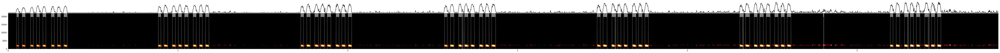

{
  "species_id": "585sso",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_585sso.wav",
  "samplerate_hz": 44100,
  "length_s": 5.817142857142857,
  "indvs": {
    "585sso": {
      "syllables": {
        "start_times": [0.05, 0.083, 0.132, 0.168, 0.204, 0.254, 0.29, 0.328, 0.884, 0.918, 0.967, 1.002, 1.039, 1.089, 1.127, 1.162, 1.724, 1.758, 1.806, 1.841, 1.879, 1.931, 1.965, 2.002, 2.569, 2.604, 2.653, 2.676, 2.688, 2.726, 2.775, 2.811, 2.847, 3.469, 3.504, 3.555, 3.576, 3.59, 3.627, 3.677, 3.713, 3.75, 4.309, 4.328, 4.342, 4.393, 4.427, 4.464, 4.515, 4.552, 4.588, 4.801, 5.195, 5.229, 5.278, 5.299, 5.313, 5.349, 5.398, 5.422, 5.436, 5.473],
        "end_times": [0.061, 0.1, 0.148, 0.184, 0.222, 0.271, 0.308, 0.347, 0.899, 0.939, 0.985, 1.021, 1.06, 1.107, 1.144, 1.182, 1.74, 1.779, 1.826, 1.862, 1.9, 1.949, 1.984, 2.023, 2.586, 2.625, 2.672, 2.679, 2.708, 2.746, 2.795, 2.832, 2.87, 3.487, 3.527, 3.573, 3.579, 3.609, 3.647, 3.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.017000000000000015
longest vocalization 0.015000000000000124
Current min_level_db: -40
longest silence 0.015000000000000124
longest vocalization 0.012000000000000455
Current min_level_db: -35
longest silence 0.014000000000000234
longest vocalization 0.011999999999999567
Current min_level_db: -30
longest silence 0.014000000000000234
longest vocalization 0.01100000000000012
Current min_level_db: -25
longest silence 0.016000000000000014
longest vocalization 0.010000000000000675
Current min_level_db: -20
longest silence 0.018000000000000016
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.04500000000000004
longest vocalization 0.006999999999999673
Current min_level_db: -10
587ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.17299999999999915
longest vocalization 0.004999999999999893
Current min_level_db: -40
longest silence 0.06899999999999995
longest vocalization 0.006000000000000227
Current min_level_db: -35
longest silence 0.018000000000000682
longest vocalization 0.013000000000000123
Current min_level_db: -30
longest silence 0.016000000000000014
longest vocalization 0.014000000000000012
Current min_level_db: -25
longest silence 0.01499999999999968
longest vocalization 0.013000000000000123
Current min_level_db: -20
longest silence 0.01499999999999968
longest vocalization 0.012000000000000455
Current min_level_db: -15
longest silence 0.019000000000000128
longest vocalization 0.01100000000000001
Current min_level_db: -10
588ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3380000000000001
longest vocalization 0.020999999999999908


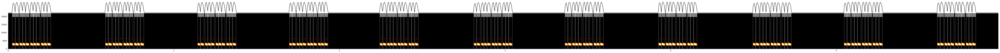

{
  "species_id": "588ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_588ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.963809523809524,
  "indvs": {
    "588ss": {
      "syllables": {
        "start_times": [0.025, 0.044, 0.069, 0.088, 0.107, 0.134, 0.152, 0.171, 0.199, 0.218, 0.237, 0.587, 0.605, 0.631, 0.65, 0.669, 0.696, 0.715, 0.734, 0.761, 0.78, 0.799, 1.144, 1.162, 1.188, 1.206, 1.226, 1.253, 1.271, 1.291, 1.318, 1.337, 1.356, 1.698, 1.716, 1.742, 1.76, 1.78, 1.806, 1.825, 1.844, 1.872, 1.89, 1.91, 2.244, 2.263, 2.288, 2.307, 2.326, 2.353, 2.371, 2.39, 2.418, 2.437, 2.456, 2.811, 2.83, 2.856, 2.874, 2.893, 2.92, 2.939, 2.958, 2.985, 3.004, 3.023, 3.362, 3.38, 3.406, 3.424, 3.444, 3.471, 3.489, 3.508, 3.536, 3.555, 3.574, 3.927, 3.946, 3.972, 3.99, 4.009, 4.036, 4.055, 4.074, 4.101, 4.12, 4.139, 4.497, 4.515, 4.54, 4.559, 4.578, 4.605, 4.624, 4.643, 4.671, 4.689, 4.709, 5.047, 5.066, 5.092, 5.11, 5.129, 5.156, 5.1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -40
longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -35
longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -30
longest silence 0.012000000000000455
longest vocalization 0.009000000000000341
Current min_level_db: -25
longest silence 0.0129999999999999
longest vocalization 0.009000000000000341
Current min_level_db: -20
longest silence 0.0129999999999999
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.014000000000000234
longest vocalization 0.007000000000000561
Current min_level_db: -10
590ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.242
longest vocalization 0.010000000000000231


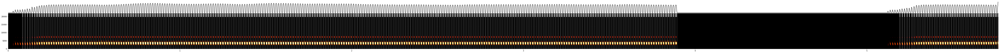

{
  "species_id": "590ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_590ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.7516553287981855,
  "indvs": {
    "590ss": {
      "syllables": {
        "start_times": [0.083, 0.097, 0.111, 0.125, 0.138, 0.152, 0.165, 0.178, 0.192, 0.206, 0.22, 0.234, 0.248, 0.262, 0.276, 0.29, 0.304, 0.318, 0.332, 0.346, 0.36, 0.374, 0.388, 0.402, 0.416, 0.43, 0.444, 0.458, 0.472, 0.486, 0.5, 0.514, 0.528, 0.542, 0.557, 0.571, 0.585, 0.599, 0.613, 0.627, 0.641, 0.655, 0.669, 0.683, 0.697, 0.711, 0.725, 0.739, 0.753, 0.767, 0.781, 0.795, 0.809, 0.823, 0.838, 0.852, 0.866, 0.88, 0.894, 0.908, 0.922, 0.936, 0.95, 0.964, 0.979, 0.993, 1.007, 1.021, 1.035, 1.049, 1.063, 1.077, 1.091, 1.105, 1.119, 1.134, 1.148, 1.162, 1.176, 1.19, 1.204, 1.218, 1.232, 1.246, 1.26, 1.274, 1.289, 1.303, 1.317, 1.331, 1.345, 1.359, 1.373, 1.387, 1.401, 1.415, 1.43, 1.444, 1.458, 1.472, 1.486, 1.5, 1.514, 1.528, 1.542, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.9309999999999999
longest vocalization 0.07899999999999996
Current min_level_db: -40
longest silence 0.298
longest vocalization 0.03599999999999959


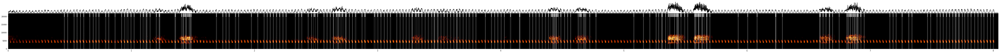

{
  "species_id": "591sl",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_591sl.wav",
  "samplerate_hz": 44100,
  "length_s": 8.021133786848072,
  "indvs": {
    "591sl": {
      "syllables": {
        "start_times": [0.455, 0.481, 0.533, 0.557, 0.585, 0.611, 0.66, 0.689, 0.711, 0.734, 0.789, 0.815, 0.866, 0.919, 0.943, 0.965, 0.994, 1.02, 1.072, 1.094, 1.118, 1.125, 1.15, 1.2, 1.224, 1.229, 1.353, 1.357, 1.405, 1.42, 1.424, 1.443, 1.45, 1.469, 1.477, 1.485, 1.689, 1.741, 1.767, 1.792, 1.844, 1.869, 1.973, 2.024, 2.076, 2.101, 2.126, 2.151, 2.176, 2.202, 2.229, 2.254, 2.33, 2.357, 2.38, 2.434, 2.462, 2.48, 2.511, 2.562, 2.587, 2.612, 2.638, 2.642, 2.661, 2.678, 2.685, 2.708, 2.736, 2.742, 2.768, 2.794, 2.817, 2.87, 2.892, 2.971, 2.996, 3.023, 3.052, 3.076, 3.101, 3.154, 3.18, 3.205, 3.23, 3.254, 3.277, 3.281, 3.305, 3.328, 3.355, 3.384, 3.41, 3.435, 3.457, 3.461, 3.483, 3.49, 3.513, 3.537, 3.564, 3.59, 3.617, 3.64, 3.645, 3.663,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.21100000000000008
longest vocalization 0.002000000000000668
Current min_level_db: -40
longest silence 0.253
longest vocalization 0.004000000000000448


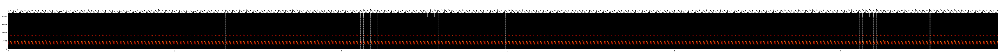

{
  "species_id": "592ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_592ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.931927437641724,
  "indvs": {
    "592ss": {
      "syllables": {
        "start_times": [1.306, 2.113, 2.134, 2.176, 2.219, 2.516, 2.558, 2.58, 2.983, 5.109, 5.13, 5.172, 5.194, 5.215, 5.534],
        "end_times": [1.309, 2.116, 2.137, 2.18, 2.222, 2.52, 2.562, 2.583, 2.986, 5.112, 5.134, 5.176, 5.197, 5.219, 5.538]
      }
    }
  }
}
593ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 5.406
longest vocalization 0.0040000000000000036


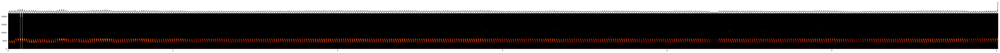

{
  "species_id": "593ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_593ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.995011337868481,
  "indvs": {
    "593ss": {
      "syllables": {
        "start_times": [0.072, 0.085],
        "end_times": [0.076, 0.088]
      }
    }
  }
}
594ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.09799999999999986
longest vocalization 0.01100000000000012
Current min_level_db: -40
longest silence 0.11500000000000021
longest vocalization 0.01100000000000012
Current min_level_db: -35
longest silence 0.11500000000000021
longest vocalization 0.01200000000000001
Current min_level_db: -30
longest silence 0.12700000000000067
longest vocalization 0.010000000000000231
Current min_level_db: -25
longest silence 0.12700000000000067
longest vocalization 0.010000000000000231
Current min_level_db: -20
longest silence 0.12700000000000067
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 1.1260000000000003
longest vocalization 0.009000000000000119


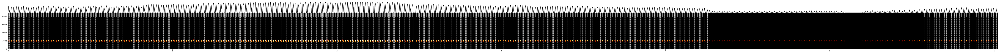

{
  "species_id": "594ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_594ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.010385487528344,
  "indvs": {
    "594ss": {
      "syllables": {
        "start_times": [0.002, 0.017, 0.032, 0.047, 0.063, 0.078, 0.093, 0.108, 0.124, 0.139, 0.154, 0.169, 0.184, 0.199, 0.214, 0.229, 0.244, 0.259, 0.274, 0.29, 0.305, 0.32, 0.335, 0.35, 0.365, 0.381, 0.396, 0.411, 0.426, 0.441, 0.456, 0.471, 0.486, 0.501, 0.517, 0.532, 0.551, 0.566, 0.582, 0.597, 0.612, 0.627, 0.642, 0.658, 0.672, 0.688, 0.703, 0.718, 0.733, 0.748, 0.763, 0.779, 0.793, 0.809, 0.824, 0.839, 0.854, 0.869, 0.884, 0.9, 0.915, 0.93, 0.945, 0.96, 0.975, 0.99, 1.005, 1.021, 1.036, 1.051, 1.066, 1.081, 1.096, 1.111, 1.127, 1.142, 1.157, 1.172, 1.187, 1.202, 1.217, 1.232, 1.248, 1.263, 1.278, 1.293, 1.308, 1.323, 1.338, 1.353, 1.369, 1.384, 1.399, 1.414, 1.429, 1.444, 1.459, 1.474, 1.489, 1.504, 1.519, 1.535, 1.55, 1.565, 1.58,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5790000000000002
longest vocalization 0.018000000000000016


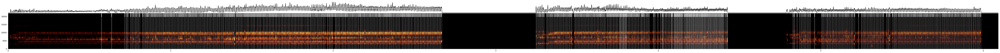

{
  "species_id": "601ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_601ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.0777777777777775,
  "indvs": {
    "601ss": {
      "syllables": {
        "start_times": [0.572, 0.635, 0.717, 0.727, 0.734, 0.752, 0.761, 0.77, 0.781, 0.789, 0.798, 0.806, 0.825, 0.834, 0.844, 0.851, 0.86, 0.87, 0.878, 0.887, 0.896, 0.905, 0.914, 0.924, 0.933, 0.942, 0.951, 0.959, 0.968, 0.977, 0.986, 0.995, 1.004, 1.013, 1.022, 1.032, 1.042, 1.049, 1.058, 1.067, 1.076, 1.085, 1.094, 1.104, 1.112, 1.121, 1.13, 1.139, 1.148, 1.158, 1.167, 1.176, 1.184, 1.194, 1.203, 1.211, 1.221, 1.229, 1.238, 1.247, 1.258, 1.266, 1.274, 1.284, 1.292, 1.301, 1.311, 1.32, 1.328, 1.338, 1.346, 1.355, 1.364, 1.373, 1.383, 1.391, 1.401, 1.409, 1.418, 1.427, 1.436, 1.446, 1.454, 1.463, 1.472, 1.481, 1.49, 1.499, 1.508, 1.517, 1.526, 1.535, 1.544, 1.553, 1.562, 1.571, 1.58, 1.59, 1.599, 1.607, 1.616, 1.625, 1.634, 1.643, 1.6

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.08800000000000008
longest vocalization 0.026000000000000023
Current min_level_db: -40
longest silence 0.08900000000000041
longest vocalization 0.025000000000000133
Current min_level_db: -35
longest silence 0.08999999999999986
longest vocalization 0.02400000000000002
Current min_level_db: -30
longest silence 0.08999999999999986
longest vocalization 0.02400000000000002
Current min_level_db: -25
longest silence 0.08999999999999986
longest vocalization 0.02400000000000002
Current min_level_db: -20
longest silence 0.09100000000000019
longest vocalization 0.02300000000000013
Current min_level_db: -15
longest silence 0.09699999999999998
longest vocalization 0.02100000000000013
Current min_level_db: -10
611ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.08900000000000041
longest vocalization 0.012000000000000455
Current min_level_db: -40
longest silence 0.08800000000000008
longest vocalization 0.01100000000000012
Current min_level_db: -35
longest silence 0.08900000000000041
longest vocalization 0.01100000000000012
Current min_level_db: -30
longest silence 0.08900000000000041
longest vocalization 0.010000000000000675
Current min_level_db: -25
longest silence 0.0900000000000003
longest vocalization 0.010000000000000675
Current min_level_db: -20
longest silence 0.0900000000000003
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.0900000000000003
longest vocalization 0.009000000000000341
Current min_level_db: -10
612ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.22799999999999998
longest vocalization 0.014000000000000234
Current min_level_db: -40
longest silence 0.22199999999999998
longest vocalization 0.015000000000000568
Current min_level_db: -35
longest silence 0.22100000000000009
longest vocalization 0.016000000000000014
Current min_level_db: -30
longest silence 0.22100000000000009
longest vocalization 0.016000000000000014
Current min_level_db: -25
longest silence 0.22100000000000009
longest vocalization 0.015000000000000568
Current min_level_db: -20
longest silence 0.22100000000000009
longest vocalization 0.015000000000000568
Current min_level_db: -15
longest silence 0.22399999999999998
longest vocalization 0.014000000000000234
Current min_level_db: -10
613ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.25900000000000006
longest vocalization 0.0129999999999999


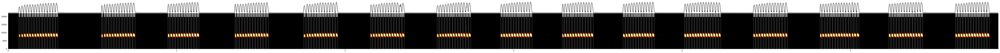

{
  "species_id": "613ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_613ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.862857142857143,
  "indvs": {
    "613ss": {
      "syllables": {
        "start_times": [0.064, 0.079, 0.094, 0.11, 0.125, 0.141, 0.156, 0.172, 0.188, 0.203, 0.219, 0.235, 0.251, 0.267, 0.283, 0.554, 0.569, 0.583, 0.599, 0.615, 0.63, 0.646, 0.662, 0.678, 0.693, 0.709, 0.725, 0.741, 0.948, 0.963, 0.979, 0.994, 1.01, 1.026, 1.042, 1.057, 1.073, 1.089, 1.105, 1.121, 1.346, 1.359, 1.374, 1.39, 1.406, 1.421, 1.437, 1.453, 1.469, 1.484, 1.5, 1.516, 1.533, 1.755, 1.773, 1.786, 1.801, 1.817, 1.833, 1.848, 1.864, 1.88, 1.896, 1.912, 1.928, 1.945, 2.151, 2.165, 2.181, 2.197, 2.212, 2.228, 2.244, 2.26, 2.276, 2.291, 2.307, 2.324, 2.339, 2.546, 2.561, 2.576, 2.592, 2.608, 2.623, 2.639, 2.655, 2.671, 2.686, 2.702, 2.718, 2.734, 2.924, 2.939, 2.955, 2.97, 2.986, 3.002, 3.018, 3.033, 3.049, 3.065, 3.081, 3.097, 3.289

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.04400000000000048
longest vocalization 0.02800000000000047
Current min_level_db: -40
longest silence 0.04400000000000048
longest vocalization 0.02800000000000047
Current min_level_db: -35
longest silence 0.04500000000000082
longest vocalization 0.027000000000000135
Current min_level_db: -30
longest silence 0.04600000000000026
longest vocalization 0.02600000000000069
Current min_level_db: -25
longest silence 0.046999999999999986
longest vocalization 0.02600000000000069
Current min_level_db: -20
longest silence 0.04899999999999999
longest vocalization 0.025000000000000355
Current min_level_db: -15
longest silence 0.054999999999999716
longest vocalization 0.02400000000000002
Current min_level_db: -10
615ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.16000000000000014
longest vocalization 0.03900000000000059
Current min_level_db: -40
longest silence 0.16000000000000014
longest vocalization 0.040000000000000036
Current min_level_db: -35
longest silence 0.16000000000000014
longest vocalization 0.040999999999999925
Current min_level_db: -30
longest silence 0.16100000000000048
longest vocalization 0.038000000000000256
Current min_level_db: -25
longest silence 0.16100000000000048
longest vocalization 0.038000000000000034
Current min_level_db: -20
longest silence 0.16300000000000026
longest vocalization 0.03699999999999992
Current min_level_db: -15
longest silence 0.16300000000000026
longest vocalization 0.03500000000000014
Current min_level_db: -10
616ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.019999999999999574
longest vocalization 0.020999999999999908
Current min_level_db: -40
longest silence 0.019999999999999574
longest vocalization 0.015000000000000568
Current min_level_db: -35
longest silence 0.020999999999999908
longest vocalization 0.014000000000000234
Current min_level_db: -30
longest silence 0.020999999999999908
longest vocalization 0.014000000000000234
Current min_level_db: -25
longest silence 0.020999999999999908
longest vocalization 0.016000000000000014
Current min_level_db: -20
longest silence 0.019999999999999574
longest vocalization 0.016000000000000014
Current min_level_db: -15
longest silence 0.02200000000000024
longest vocalization 0.012000000000000455
Current min_level_db: -10
617ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3730000000000002
longest vocalization 0.007000000000000006


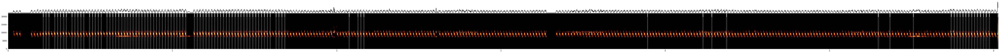

{
  "species_id": "617ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_617ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.013922902494331,
  "indvs": {
    "617ss": {
      "syllables": {
        "start_times": [0.212, 0.229, 0.247, 0.282, 0.3, 0.317, 0.335, 0.352, 0.387, 0.405, 0.423, 0.441, 0.459, 0.494, 0.512, 0.529, 0.547, 0.565, 0.6, 0.617, 0.635, 0.652, 0.67, 0.688, 0.706, 0.723, 0.741, 0.759, 0.777, 0.795, 0.813, 0.831, 0.848, 0.866, 0.884, 0.901, 0.919, 0.937, 0.955, 0.973, 0.99, 1.008, 1.026, 1.043, 1.06, 1.078, 1.132, 1.15, 1.167, 1.185, 1.203, 1.221, 1.238, 1.256, 1.273, 1.291, 1.309, 1.327, 1.344, 1.362, 1.38, 1.398, 1.416, 1.434, 1.452, 1.47, 1.488, 1.505, 1.523, 1.541, 1.558, 1.576, 1.594, 1.629, 1.647, 1.665, 1.683, 2.075, 2.128, 2.146, 2.164, 3.891, 4.229, 4.283, 4.372, 5.296, 5.367, 5.51, 5.74, 5.758, 5.776, 5.794, 5.811, 5.829, 5.847, 5.865, 5.883, 5.899, 5.917, 5.936, 5.953, 5.972, 6.025],
        "end_t

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2370000000000001
longest vocalization 0.013000000000000345
Current min_level_db: -40
longest silence 0.2370000000000001
longest vocalization 0.012000000000000455
Current min_level_db: -35
longest silence 0.238
longest vocalization 0.01200000000000001
Current min_level_db: -30
longest silence 0.238
longest vocalization 0.01100000000000012
Current min_level_db: -25
longest silence 0.2400000000000002
longest vocalization 0.010000000000000231
Current min_level_db: -20
longest silence 0.2400000000000002
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.2410000000000001
longest vocalization 0.008000000000000007
Current min_level_db: -10
619ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2629999999999999
longest vocalization 0.013000000000000345


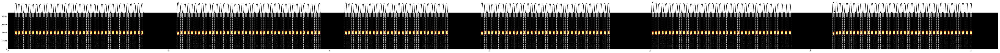

{
  "species_id": "619ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_619ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.154829931972789,
  "indvs": {
    "619ss": {
      "syllables": {
        "start_times": [0.042, 0.063, 0.084, 0.105, 0.127, 0.15, 0.172, 0.194, 0.216, 0.239, 0.261, 0.284, 0.306, 0.329, 0.352, 0.375, 0.397, 0.42, 0.443, 0.466, 0.488, 0.512, 0.535, 0.557, 0.58, 0.602, 0.625, 0.647, 0.671, 0.693, 0.716, 0.738, 0.761, 0.783, 0.807, 0.83, 1.054, 1.074, 1.096, 1.118, 1.14, 1.162, 1.184, 1.206, 1.228, 1.251, 1.273, 1.296, 1.318, 1.341, 1.363, 1.386, 1.409, 1.431, 1.455, 1.477, 1.499, 1.522, 1.545, 1.568, 1.59, 1.613, 1.635, 1.658, 1.681, 1.704, 1.726, 1.749, 1.771, 1.794, 1.817, 1.84, 1.863, 1.886, 1.909, 1.933, 2.098, 2.119, 2.14, 2.161, 2.183, 2.205, 2.227, 2.25, 2.272, 2.294, 2.316, 2.339, 2.362, 2.385, 2.407, 2.43, 2.453, 2.476, 2.498, 2.521, 2.544, 2.566, 2.589, 2.612, 2.634, 2.657, 2.679, 2.703, 2.726,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.256
longest vocalization 0.031000000000000583


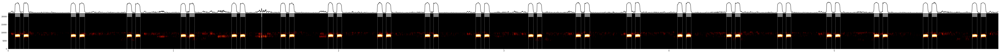

{
  "species_id": "621ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_621ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.9787301587301585,
  "indvs": {
    "621ss": {
      "syllables": {
        "start_times": [0.042, 0.094, 0.38, 0.432, 0.719, 0.771, 1.045, 1.098, 1.353, 1.405, 1.533, 1.65, 1.702, 1.937, 1.991, 2.235, 2.288, 2.523, 2.575, 2.83, 2.883, 3.149, 3.202, 3.436, 3.49, 3.744, 3.796, 4.051, 4.104, 4.348, 4.401, 4.657, 4.709, 4.954, 5.007, 5.241, 5.294, 5.538, 5.592, 5.835, 5.888],
        "end_times": [0.071, 0.124, 0.41, 0.463, 0.749, 0.8, 1.076, 1.128, 1.383, 1.435, 1.536, 1.68, 1.732, 1.968, 2.02, 2.266, 2.318, 2.553, 2.605, 2.861, 2.913, 3.179, 3.231, 3.467, 3.521, 3.774, 3.826, 4.082, 4.134, 4.379, 4.432, 4.687, 4.739, 4.985, 5.037, 5.272, 5.324, 5.569, 5.622, 5.866, 5.919]
      }
    }
  }
}
622ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.44899999999999984
longest vocalization 0.02100000000000013


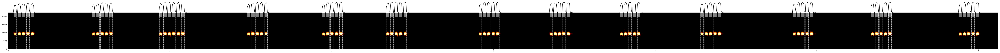

{
  "species_id": "622ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_622ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.106213151927438,
  "indvs": {
    "622ss": {
      "syllables": {
        "start_times": [0.035, 0.06, 0.086, 0.113, 0.141, 0.519, 0.544, 0.571, 0.598, 0.626, 0.935, 0.96, 0.987, 1.014, 1.042, 1.071, 1.478, 1.503, 1.53, 1.557, 1.585, 1.942, 1.966, 1.992, 2.02, 2.048, 2.338, 2.363, 2.39, 2.417, 2.445, 2.912, 2.935, 2.961, 2.989, 3.017, 3.348, 3.373, 3.399, 3.426, 3.454, 3.783, 3.808, 3.834, 3.862, 3.89, 4.281, 4.306, 4.333, 4.36, 4.388, 4.851, 4.877, 4.903, 4.93, 4.958, 5.334, 5.361, 5.387, 5.415, 5.442, 5.877, 5.903, 5.929, 5.956, 5.984],
        "end_times": [0.051, 0.079, 0.105, 0.132, 0.16, 0.536, 0.564, 0.591, 0.617, 0.645, 0.953, 0.981, 1.005, 1.034, 1.061, 1.09, 1.496, 1.524, 1.55, 1.575, 1.603, 1.959, 1.986, 2.012, 2.039, 2.067, 2.356, 2.382, 2.408, 2.435, 2.463, 2.927, 2.955, 2.981, 3.008, 3.037

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.43099999999999994
longest vocalization 0.017000000000000348


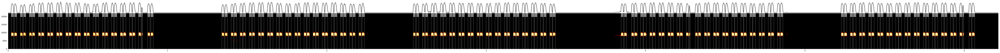

{
  "species_id": "623ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_623ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.198548752834467,
  "indvs": {
    "623ss": {
      "syllables": {
        "start_times": [0.019, 0.039, 0.076, 0.096, 0.133, 0.152, 0.19, 0.209, 0.247, 0.266, 0.304, 0.323, 0.362, 0.381, 0.418, 0.437, 0.476, 0.495, 0.533, 0.552, 0.59, 0.609, 0.647, 0.666, 0.704, 0.723, 0.761, 0.781, 0.818, 0.839, 0.876, 0.895, 1.341, 1.361, 1.399, 1.418, 1.455, 1.475, 1.512, 1.532, 1.57, 1.589, 1.627, 1.646, 1.684, 1.703, 1.741, 1.76, 1.799, 1.818, 1.856, 1.875, 1.913, 1.932, 1.97, 1.989, 2.027, 2.047, 2.085, 2.105, 2.143, 2.163, 2.2, 2.22, 2.542, 2.562, 2.599, 2.618, 2.655, 2.675, 2.713, 2.732, 2.77, 2.789, 2.827, 2.847, 2.885, 2.904, 2.942, 2.961, 2.999, 3.018, 3.055, 3.074, 3.113, 3.132, 3.17, 3.189, 3.226, 3.246, 3.284, 3.303, 3.341, 3.361, 3.398, 3.418, 3.846, 3.866, 3.912, 3.931, 3.969, 3.988, 4.026, 4.046, 4.083,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.47099999999999964
longest vocalization 0.010000000000000675


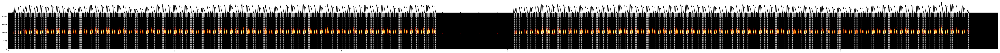

{
  "species_id": "624ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_624ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.934149659863945,
  "indvs": {
    "624ss": {
      "syllables": {
        "start_times": [0.039, 0.062, 0.071, 0.094, 0.103, 0.125, 0.135, 0.158, 0.168, 0.191, 0.201, 0.224, 0.235, 0.257, 0.268, 0.29, 0.301, 0.324, 0.334, 0.357, 0.368, 0.39, 0.401, 0.423, 0.434, 0.457, 0.467, 0.49, 0.501, 0.524, 0.534, 0.557, 0.568, 0.59, 0.601, 0.624, 0.635, 0.658, 0.668, 0.691, 0.702, 0.725, 0.736, 0.761, 0.77, 0.793, 0.803, 0.826, 0.837, 0.86, 0.87, 0.893, 0.904, 0.927, 0.937, 0.96, 0.971, 0.994, 1.004, 1.028, 1.038, 1.061, 1.071, 1.095, 1.105, 1.128, 1.139, 1.162, 1.173, 1.196, 1.206, 1.23, 1.24, 1.263, 1.274, 1.297, 1.307, 1.331, 1.341, 1.364, 1.375, 1.398, 1.41, 1.432, 1.442, 1.466, 1.476, 1.5, 1.511, 1.534, 1.545, 1.568, 1.578, 1.601, 1.612, 1.635, 1.645, 1.668, 1.679, 1.702, 1.713, 1.736, 1.746, 1.77, 1.78, 1.80

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.05600000000000005
longest vocalization 0.019000000000000128
Current min_level_db: -40
longest silence 0.05600000000000005
longest vocalization 0.019000000000000128
Current min_level_db: -35
longest silence 0.05799999999999983
longest vocalization 0.018000000000000682
Current min_level_db: -30
longest silence 0.05799999999999983
longest vocalization 0.018000000000000016
Current min_level_db: -25
longest silence 0.058999999999999275
longest vocalization 0.016000000000000014
Current min_level_db: -20
longest silence 0.06099999999999994
longest vocalization 0.014999999999999902
Current min_level_db: -15
longest silence 0.09299999999999997
longest vocalization 0.012000000000000455
Current min_level_db: -10
632ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.016000000000000014
longest vocalization 0.009000000000000341
Current min_level_db: -40
longest silence 0.010000000000000231
longest vocalization 0.02400000000000002
Current min_level_db: -35
longest silence 0.009000000000000341
longest vocalization 0.02400000000000002
Current min_level_db: -30
longest silence 0.010000000000000231
longest vocalization 0.022999999999999687
Current min_level_db: -25
longest silence 0.01200000000000001
longest vocalization 0.01100000000000012
Current min_level_db: -20
longest silence 0.013000000000000345
longest vocalization 0.010000000000000675
Current min_level_db: -15
longest silence 0.03700000000000003
longest vocalization 0.007000000000000006
Current min_level_db: -10
641ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.04899999999999993
longest vocalization 0.009999999999999787
Current min_level_db: -40
longest silence 0.04899999999999993
longest vocalization 0.009999999999999787
Current min_level_db: -35
longest silence 0.04899999999999993
longest vocalization 0.009000000000000341
Current min_level_db: -30
longest silence 0.04899999999999993
longest vocalization 0.009000000000000341
Current min_level_db: -25
longest silence 0.04999999999999982
longest vocalization 0.009000000000000341
Current min_level_db: -20
longest silence 0.04999999999999982
longest vocalization 0.008000000000000007
Current min_level_db: -15
longest silence 0.050999999999999934
longest vocalization 0.007000000000000561
Current min_level_db: -10
671ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5880000000000001
longest vocalization 0.19099999999999984
Current min_level_db: -40
longest silence 0.5899999999999999
longest vocalization 0.05699999999999994
Current min_level_db: -35
longest silence 0.5909999999999997
longest vocalization 0.018000000000000016


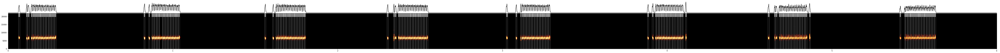

{
  "species_id": "671ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_671ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.986712018140589,
  "indvs": {
    "671ss": {
      "syllables": {
        "start_times": [0.063, 0.11, 0.12, 0.139, 0.149, 0.158, 0.168, 0.178, 0.187, 0.196, 0.206, 0.216, 0.226, 0.235, 0.245, 0.254, 0.264, 0.273, 0.283, 0.824, 0.853, 0.871, 0.88, 0.89, 0.899, 0.909, 0.918, 0.938, 0.947, 0.957, 0.966, 0.976, 0.985, 0.995, 1.005, 1.014, 1.024, 1.034, 1.557, 1.605, 1.624, 1.633, 1.643, 1.653, 1.662, 1.672, 1.681, 1.691, 1.7, 1.71, 1.72, 1.73, 1.739, 1.749, 1.759, 1.768, 1.778, 1.788, 1.797, 2.3, 2.339, 2.348, 2.367, 2.376, 2.386, 2.395, 2.405, 2.415, 2.424, 2.434, 2.443, 2.453, 2.462, 2.472, 2.482, 2.491, 2.501, 2.511, 2.521, 2.53, 2.54, 3.023, 3.081, 3.109, 3.119, 3.128, 3.137, 3.147, 3.157, 3.166, 3.176, 3.185, 3.195, 3.205, 3.214, 3.224, 3.233, 3.243, 3.253, 3.263, 3.272, 3.282, 3.881, 3.909, 3.928, 3.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.579
longest vocalization 0.018000000000000682


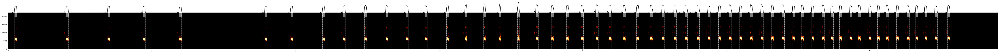

{
  "species_id": "672ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_672ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.878458049886621,
  "indvs": {
    "672ss": {
      "syllables": {
        "start_times": [0.045, 0.404, 0.693, 0.938, 1.192, 1.787, 1.967, 2.189, 2.331, 2.481, 2.63, 2.771, 2.903, 3.053, 3.181, 3.311, 3.419, 3.547, 3.675, 3.783, 3.888, 3.99, 4.093, 4.184, 4.283, 4.376, 4.471, 4.552, 4.637, 4.714, 4.798, 4.872, 4.947, 5.021, 5.094, 5.168, 5.242, 5.315, 5.389, 5.463, 5.524, 5.595, 5.669, 5.729, 5.789, 5.861, 5.921, 5.994, 6.054, 6.115, 6.186, 6.26, 6.32, 6.382, 6.453, 6.542],
        "end_times": [0.061, 0.42, 0.709, 0.955, 1.208, 1.803, 1.983, 2.205, 2.348, 2.497, 2.647, 2.787, 2.919, 3.069, 3.195, 3.325, 3.43, 3.561, 3.692, 3.8, 3.905, 4.007, 4.11, 4.201, 4.301, 4.394, 4.489, 4.57, 4.654, 4.731, 4.815, 4.89, 4.964, 5.038, 5.111, 5.186, 5.259, 5.333, 5.406, 5.48, 5.541, 5.613, 5.686, 5.747, 5.807, 5.878,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.6219999999999999
longest vocalization 0.010000000000000231


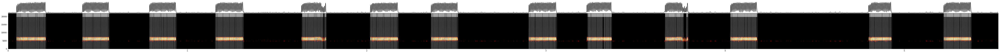

{
  "species_id": "679ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_679ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.511337868480726,
  "indvs": {
    "679ss": {
      "syllables": {
        "start_times": [0.047, 0.052, 0.057, 0.062, 0.067, 0.072, 0.077, 0.082, 0.087, 0.092, 0.097, 0.102, 0.108, 0.113, 0.118, 0.123, 0.128, 0.133, 0.138, 0.143, 0.148, 0.154, 0.159, 0.164, 0.169, 0.174, 0.179, 0.184, 0.189, 0.194, 0.2, 0.205, 0.415, 0.42, 0.425, 0.43, 0.435, 0.44, 0.445, 0.45, 0.455, 0.46, 0.465, 0.471, 0.476, 0.481, 0.486, 0.491, 0.496, 0.501, 0.506, 0.511, 0.517, 0.522, 0.527, 0.532, 0.537, 0.542, 0.547, 0.552, 0.558, 0.789, 0.794, 0.799, 0.803, 0.809, 0.814, 0.819, 0.824, 0.829, 0.834, 0.839, 0.844, 0.85, 0.855, 0.86, 0.865, 0.87, 0.875, 0.88, 0.886, 0.891, 0.896, 0.901, 0.906, 0.911, 0.916, 0.921, 0.927, 0.932, 1.158, 1.163, 1.168, 1.173, 1.178, 1.183, 1.188, 1.193, 1.199, 1.204, 1.209, 1.214, 1.219, 1.224, 1.229, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.2110000000000003
longest vocalization 0.026000000000000023


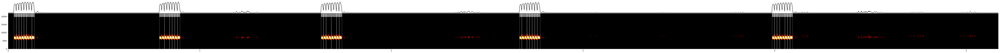

{
  "species_id": "681ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_681ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.154331065759637,
  "indvs": {
    "681ss": {
      "syllables": {
        "start_times": [0.03, 0.043, 0.057, 0.07, 0.083, 0.097, 0.124, 0.789, 0.816, 0.843, 0.856, 0.87, 0.884, 1.633, 1.646, 1.66, 1.687, 1.714, 1.728, 2.669, 2.681, 2.708, 2.722, 2.735, 2.749, 2.762, 3.987, 4.0, 4.013, 4.027, 4.054, 4.067, 4.081],
        "end_times": [0.042, 0.056, 0.069, 0.082, 0.096, 0.123, 0.137, 0.815, 0.842, 0.855, 0.869, 0.883, 0.897, 1.645, 1.659, 1.686, 1.713, 1.727, 1.742, 2.68, 2.707, 2.721, 2.734, 2.748, 2.761, 2.776, 3.999, 4.012, 4.026, 4.053, 4.066, 4.08, 4.094]
      }
    }
  }
}
682ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.3139999999999996
longest vocalization 0.05699999999999994
Current min_level_db: -40
longest silence 1.3139999999999996
longest vocalization 0.05500000000000016
Current min_level_db: -35
longest silence 1.3169999999999997
longest vocalization 0.05500000000000016
Current min_level_db: -30
longest silence 1.3179999999999996
longest vocalization 0.05400000000000027
Current min_level_db: -25
longest silence 1.3179999999999996
longest vocalization 0.052999999999999936
Current min_level_db: -20
longest silence 1.3210000000000002
longest vocalization 0.04899999999999993


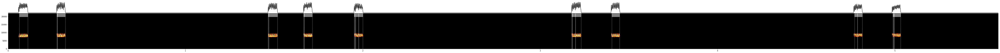

{
  "species_id": "682ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_682ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.569433106575964,
  "indvs": {
    "682ss": {
      "syllables": {
        "start_times": [0.063, 0.274, 0.278, 1.466, 1.47, 1.666, 1.67, 1.951, 1.955, 1.96, 1.977, 3.178, 3.182, 3.2, 3.404, 4.773, 4.79, 4.989, 4.993, 4.997],
        "end_times": [0.111, 0.277, 0.322, 1.469, 1.519, 1.669, 1.715, 1.954, 1.958, 1.976, 2.0, 3.181, 3.199, 3.231, 3.448, 4.789, 4.817, 4.992, 4.996, 5.033]
      }
    }
  }
}
683ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 5.162
longest vocalization 0.0259999999999998


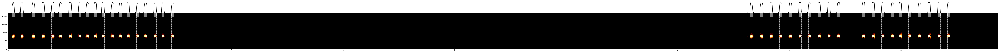

{
  "species_id": "683ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_683ss.wav",
  "samplerate_hz": 44100,
  "length_s": 8.85156462585034,
  "indvs": {
    "683ss": {
      "syllables": {
        "start_times": [0.036, 0.112, 0.215, 0.302, 0.389, 0.459, 0.544, 0.631, 0.7, 0.769, 0.838, 0.925, 0.995, 1.064, 1.15, 1.22, 1.306, 1.376, 1.463, 6.649, 6.74, 6.826, 6.912, 6.999, 7.085, 7.171, 7.257, 7.343, 7.43, 7.654, 7.741, 7.827, 7.913, 7.983, 8.068, 8.155, 8.242, 8.329, 8.417],
        "end_times": [0.057, 0.136, 0.24, 0.327, 0.414, 0.483, 0.569, 0.655, 0.725, 0.794, 0.863, 0.95, 1.019, 1.088, 1.175, 1.244, 1.33, 1.4, 1.487, 6.673, 6.766, 6.85, 6.936, 7.023, 7.109, 7.195, 7.281, 7.367, 7.454, 7.678, 7.765, 7.852, 7.938, 8.007, 8.092, 8.179, 8.266, 8.354, 8.441]
      }
    }
  }
}
684ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.9370000000000003
longest vocalization 0.02200000000000024


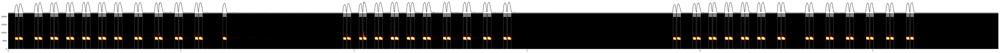

{
  "species_id": "684ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_684ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.711972789115646,
  "indvs": {
    "684ss": {
      "syllables": {
        "start_times": [0.04, 0.063, 0.153, 0.176, 0.244, 0.267, 0.336, 0.36, 0.429, 0.452, 0.522, 0.545, 0.614, 0.638, 0.731, 0.754, 0.848, 0.871, 0.964, 0.987, 1.08, 1.103, 1.241, 1.937, 1.96, 2.029, 2.052, 2.12, 2.144, 2.213, 2.236, 2.305, 2.329, 2.399, 2.423, 2.515, 2.538, 2.631, 2.654, 2.747, 2.771, 2.864, 2.887, 3.845, 3.867, 3.959, 3.982, 4.051, 4.075, 4.145, 4.168, 4.238, 4.262, 4.332, 4.356, 4.449, 4.472, 4.611, 4.635, 4.729, 4.752, 4.845, 4.868, 4.961, 4.984, 5.077, 5.101, 5.194, 5.217],
        "end_times": [0.057, 0.084, 0.171, 0.197, 0.263, 0.289, 0.355, 0.381, 0.447, 0.474, 0.54, 0.566, 0.633, 0.659, 0.749, 0.776, 0.867, 0.893, 0.983, 1.009, 1.099, 1.124, 1.262, 1.955, 1.981, 2.047, 2.072, 2.139, 2.165, 2.231, 2.257, 2.324, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.7889999999999997
longest vocalization 0.02100000000000013


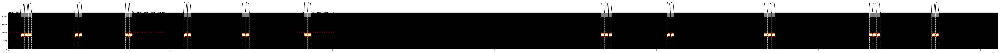

{
  "species_id": "685ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_685ss.wav",
  "samplerate_hz": 44100,
  "length_s": 6.094603174603175,
  "indvs": {
    "685ss": {
      "syllables": {
        "start_times": [0.078, 0.101, 0.125, 0.412, 0.436, 0.724, 0.748, 1.084, 1.107, 1.444, 1.468, 1.827, 1.851, 3.659, 3.682, 3.706, 4.065, 4.089, 4.665, 4.689, 4.713, 5.314, 5.337, 5.361, 5.698, 5.722],
        "end_times": [0.098, 0.122, 0.144, 0.431, 0.455, 0.744, 0.766, 1.104, 1.127, 1.465, 1.488, 1.847, 1.87, 3.679, 3.702, 3.724, 4.085, 4.107, 4.685, 4.709, 4.732, 5.334, 5.357, 5.38, 5.719, 5.741]
      }
    }
  }
}
686ss


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.9320000000000002
longest vocalization 0.05399999999999999
Current min_level_db: -40
longest silence 1.9330000000000003
longest vocalization 0.018000000000000016


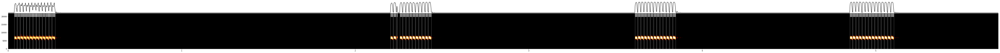

{
  "species_id": "686ss",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_686ss.wav",
  "samplerate_hz": 44100,
  "length_s": 5.692380952380953,
  "indvs": {
    "686ss": {
      "syllables": {
        "start_times": [0.036, 0.053, 0.071, 0.089, 0.107, 0.125, 0.143, 0.162, 0.18, 0.199, 0.217, 0.236, 0.254, 2.204, 2.222, 2.24, 2.258, 2.276, 2.294, 2.313, 2.331, 2.349, 2.368, 2.386, 2.405, 2.423, 3.613, 3.63, 3.648, 3.666, 3.685, 3.703, 3.721, 3.739, 3.758, 3.776, 3.795, 3.813, 3.832, 4.851, 4.869, 4.887, 4.905, 4.923, 4.941, 4.96, 4.978, 4.996, 5.015, 5.033, 5.052, 5.07, 5.089],
        "end_times": [0.05, 0.068, 0.087, 0.105, 0.123, 0.142, 0.161, 0.178, 0.196, 0.214, 0.234, 0.251, 0.271, 2.218, 2.236, 2.244, 2.272, 2.291, 2.309, 2.327, 2.346, 2.364, 2.383, 2.401, 2.419, 2.439, 3.627, 3.645, 3.663, 3.681, 3.699, 3.717, 3.736, 3.754, 3.772, 3.791, 3.809, 3.828, 3.847, 4.866, 4.884, 4.901, 4.92, 4.938, 4.956, 4.975, 4.993, 5.011, 5

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -40
longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -35
longest silence 0.01100000000000012
longest vocalization 0.010000000000000675
Current min_level_db: -30
longest silence 0.012000000000000455
longest vocalization 0.009000000000000341
Current min_level_db: -25
longest silence 0.0129999999999999
longest vocalization 0.009000000000000341
Current min_level_db: -20
longest silence 0.0129999999999999
longest vocalization 0.009000000000000341
Current min_level_db: -15
longest silence 0.014000000000000234
longest vocalization 0.007000000000000561
Current min_level_db: -10
enma-koorogi


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.7560000000000002
longest vocalization 0.040000000000000036


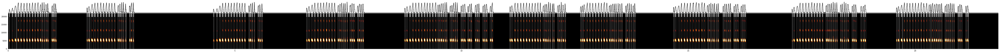

{
  "species_id": "enma-koorogi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_enma-koorogi.wav",
  "samplerate_hz": 44100,
  "length_s": 21.783219954648526,
  "indvs": {
    "enma-koorogi": {
      "syllables": {
        "start_times": [0.025, 0.083, 0.145, 0.18, 0.208, 0.273, 0.338, 0.403, 0.463, 0.524, 0.584, 0.643, 0.703, 0.748, 0.79, 0.83, 0.869, 0.96, 0.996, 1.042, 1.735, 1.768, 1.798, 1.832, 1.896, 1.962, 2.028, 2.092, 2.153, 2.216, 2.276, 2.337, 2.416, 2.455, 2.502, 2.54, 2.588, 2.599, 2.672, 2.705, 2.756, 4.527, 4.594, 4.652, 4.716, 4.78, 4.845, 4.908, 4.972, 5.034, 5.093, 5.15, 5.21, 5.302, 5.335, 5.382, 5.427, 5.508, 5.545, 5.59, 6.579, 6.619, 6.684, 6.749, 6.814, 6.878, 6.943, 7.007, 7.068, 7.129, 7.188, 7.268, 7.307, 7.352, 7.397, 7.428, 7.472, 7.534, 7.573, 7.617, 7.699, 7.734, 7.779, 7.817, 8.742, 8.782, 8.847, 8.911, 8.975, 9.041, 9.106, 9.169, 9.231, 9.29, 9.348, 9.413, 9.471, 9.507, 9.543, 9.587, 9.632, 9.667

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.2379999999999995
longest vocalization 0.02400000000000002


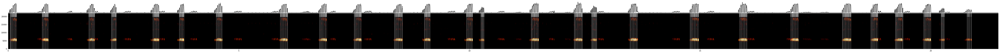

{
  "species_id": "ezo-enma",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_ezo-enma.wav",
  "samplerate_hz": 44100,
  "length_s": 21.41170068027211,
  "indvs": {
    "ezo-enma": {
      "syllables": {
        "start_times": [0.05, 0.054, 0.073, 0.1, 0.13, 0.16, 0.737, 0.76, 0.786, 0.817, 0.848, 1.746, 1.771, 1.8, 1.83, 1.86, 2.24, 2.256, 2.278, 2.304, 2.333, 3.135, 3.161, 3.189, 3.221, 3.251, 3.709, 3.732, 3.762, 3.791, 4.509, 4.534, 4.563, 4.592, 4.624, 5.899, 5.925, 5.953, 5.983, 6.015, 6.049, 6.748, 6.769, 6.792, 6.82, 6.85, 6.883, 7.502, 7.522, 7.544, 7.571, 7.601, 7.632, 8.373, 8.394, 8.415, 8.443, 8.472, 8.504, 8.538, 9.02, 9.04, 9.068, 9.097, 9.128, 9.931, 9.956, 9.984, 10.015, 10.046, 10.247, 10.265, 10.285, 10.305, 11.334, 11.355, 11.383, 11.414, 11.446, 11.477, 12.269, 12.288, 12.313, 12.341, 12.372, 12.404, 12.436, 12.648, 12.666, 12.685, 12.706, 12.727, 12.75, 13.479, 13.502, 13.53, 13.56, 13.591, 13.624, 14.781, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.628
longest vocalization 0.008000000000000895


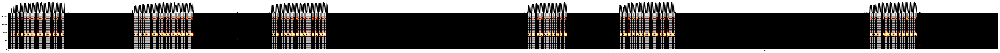

{
  "species_id": "ezo-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_ezo-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 13.052517006802722,
  "indvs": {
    "ezo-suzu": {
      "syllables": {
        "start_times": [0.041, 0.068, 0.078, 0.089, 0.099, 0.11, 0.121, 0.131, 0.142, 0.152, 0.164, 0.174, 0.185, 0.195, 0.206, 0.217, 0.228, 0.238, 0.248, 0.259, 0.269, 0.28, 0.291, 0.301, 0.312, 0.322, 0.333, 0.343, 0.354, 0.365, 0.375, 0.386, 0.396, 0.407, 0.417, 0.428, 0.438, 0.449, 0.46, 0.47, 0.481, 0.491, 0.502, 0.512, 0.523, 0.534, 0.544, 0.555, 0.565, 0.576, 0.586, 0.597, 0.607, 0.618, 0.628, 0.639, 0.649, 0.66, 0.671, 0.681, 0.692, 0.702, 0.713, 0.724, 0.735, 0.746, 1.671, 1.682, 1.692, 1.703, 1.714, 1.724, 1.735, 1.746, 1.756, 1.767, 1.777, 1.788, 1.799, 1.809, 1.82, 1.83, 1.841, 1.852, 1.862, 1.873, 1.883, 1.894, 1.904, 1.915, 1.925, 1.936, 1.946, 1.957, 1.967, 1.978, 1.988, 1.999, 2.009, 2.02, 2.03, 2.041, 2.051, 2.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.019
longest vocalization 0.029999999999999805


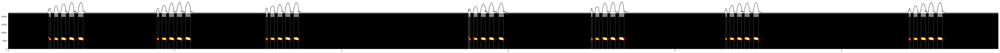

{
  "species_id": "fall",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_fall_field_cricket.wav",
  "samplerate_hz": 44100,
  "length_s": 5.926303854875283,
  "indvs": {
    "fall": {
      "syllables": {
        "start_times": [0.245, 0.277, 0.319, 0.366, 0.421, 0.893, 0.923, 0.966, 1.013, 1.064, 1.547, 1.574, 1.617, 1.663, 1.714, 2.762, 2.766, 2.794, 2.837, 2.886, 2.944, 3.498, 3.524, 3.566, 3.614, 3.665, 4.304, 4.33, 4.374, 4.419, 4.472, 5.405, 5.433, 5.476, 5.523, 5.576],
        "end_times": [0.255, 0.298, 0.345, 0.395, 0.45, 0.904, 0.947, 0.994, 1.042, 1.093, 1.557, 1.597, 1.644, 1.692, 1.743, 2.765, 2.773, 2.815, 2.864, 2.913, 2.972, 3.505, 3.545, 3.594, 3.642, 3.695, 4.312, 4.354, 4.4, 4.447, 4.502, 5.413, 5.455, 5.504, 5.551, 5.604]
      }
    }
  }
}
fieldcricket1


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.30799999999999994
longest vocalization 0.02800000000000047


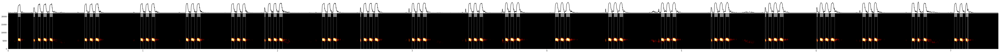

{
  "species_id": "fieldcricket1",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_fieldcricket1.wav",
  "samplerate_hz": 44100,
  "length_s": 7.335963718820862,
  "indvs": {
    "fieldcricket1": {
      "syllables": {
        "start_times": [0.073, 0.189, 0.222, 0.263, 0.309, 0.568, 0.607, 0.649, 0.983, 1.023, 1.066, 1.321, 1.359, 1.403, 1.658, 1.7, 1.742, 1.904, 1.931, 1.972, 2.014, 2.332, 2.374, 2.414, 2.616, 2.641, 2.682, 2.724, 2.999, 3.039, 3.081, 3.42, 3.459, 3.502, 3.692, 3.732, 3.776, 4.063, 4.104, 4.145, 4.458, 4.499, 4.541, 4.85, 4.891, 4.935, 5.22, 5.245, 5.286, 5.328, 5.622, 5.647, 5.687, 5.731, 6.005, 6.029, 6.069, 6.111, 6.345, 6.391, 6.433, 6.712, 6.754, 6.799, 7.027, 7.068, 7.111, 7.127],
        "end_times": [0.091, 0.198, 0.24, 0.285, 0.33, 0.584, 0.629, 0.675, 1.002, 1.045, 1.09, 1.338, 1.384, 1.427, 1.679, 1.724, 1.764, 1.91, 1.951, 1.993, 2.037, 2.353, 2.396, 2.439, 2.62, 2.663, 2.706, 2.747, 3.018, 3.059, 3

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.7929999999999993
longest vocalization 0.012000000000000455


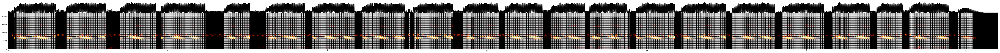

{
  "species_id": "hama-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_hama-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 30.934784580498867,
  "indvs": {
    "hama-suzu": {
      "syllables": {
        "start_times": [0.193, 0.207, 0.22, 0.234, 0.249, 0.263, 0.278, 0.292, 0.307, 0.322, 0.338, 0.353, 0.368, 0.383, 0.399, 0.413, 0.429, 0.444, 0.459, 0.474, 0.49, 0.504, 0.52, 0.535, 0.551, 0.566, 0.581, 0.596, 0.611, 0.627, 0.642, 0.658, 0.673, 0.688, 0.703, 0.718, 0.734, 0.749, 0.764, 0.779, 0.794, 0.81, 0.825, 0.84, 0.856, 0.871, 0.887, 0.901, 0.918, 0.933, 0.947, 0.964, 0.978, 0.993, 1.009, 1.024, 1.039, 1.055, 1.07, 1.084, 1.101, 1.116, 1.131, 1.147, 1.162, 1.178, 1.193, 1.208, 1.223, 1.238, 1.254, 1.269, 1.284, 1.299, 1.314, 1.33, 1.345, 1.361, 1.376, 1.391, 1.406, 1.422, 1.436, 1.45, 1.467, 1.483, 1.814, 1.828, 1.842, 1.856, 1.87, 1.884, 1.899, 1.914, 1.929, 1.944, 1.959, 1.974, 1.99, 2.005, 2.02, 2.036, 2.05, 2.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.8289999999999997
longest vocalization 0.011000000000002785


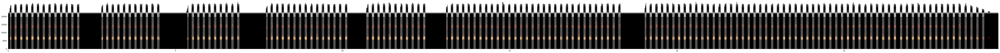

{
  "species_id": "haraokame",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_haraokame.wav",
  "samplerate_hz": 44100,
  "length_s": 29.53578231292517,
  "indvs": {
    "haraokame": {
      "syllables": {
        "start_times": [0.052, 0.067, 0.083, 0.192, 0.208, 0.225, 0.241, 0.361, 0.377, 0.393, 0.409, 0.529, 0.546, 0.563, 0.579, 0.696, 0.712, 0.729, 0.745, 0.865, 0.881, 0.897, 0.914, 1.035, 1.051, 1.068, 1.085, 1.21, 1.227, 1.243, 1.259, 1.383, 1.4, 1.417, 1.433, 1.556, 1.573, 1.589, 1.605, 1.721, 1.738, 1.754, 1.771, 1.888, 1.905, 1.922, 1.938, 2.064, 2.081, 2.099, 2.114, 2.794, 2.81, 2.825, 2.935, 2.951, 2.968, 2.984, 3.101, 3.118, 3.135, 3.151, 3.268, 3.285, 3.302, 3.318, 3.438, 3.455, 3.472, 3.488, 3.606, 3.623, 3.64, 3.656, 3.777, 3.794, 3.811, 3.827, 3.946, 3.962, 3.98, 3.996, 4.118, 4.134, 4.152, 4.167, 4.289, 4.307, 4.324, 4.34, 4.46, 4.476, 4.493, 4.509, 5.363, 5.377, 5.49, 5.507, 5.523, 5.539, 5.654, 5.671, 5.688, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.5
longest vocalization 0.014000000000002899


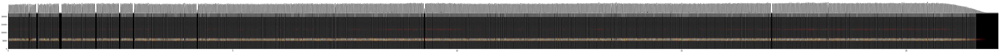

{
  "species_id": "hime-koorogi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_hime-koorogi.wav",
  "samplerate_hz": 44100,
  "length_s": 21.99800453514739,
  "indvs": {
    "hime-koorogi": {
      "syllables": {
        "start_times": [0.017, 0.044, 0.071, 0.1, 0.128, 0.156, 0.184, 0.211, 0.239, 0.27, 0.297, 0.323, 0.351, 0.384, 0.41, 0.436, 0.47, 0.496, 0.524, 0.55, 0.578, 0.606, 0.668, 0.691, 0.72, 0.747, 0.777, 0.805, 0.834, 0.861, 0.889, 0.923, 0.948, 0.974, 1.003, 1.032, 1.059, 1.087, 1.119, 1.197, 1.225, 1.253, 1.282, 1.31, 1.336, 1.365, 1.391, 1.422, 1.448, 1.476, 1.502, 1.529, 1.557, 1.586, 1.615, 1.646, 1.669, 1.698, 1.726, 1.754, 1.782, 1.809, 1.837, 1.865, 1.894, 1.92, 1.975, 2.003, 2.032, 2.061, 2.092, 2.117, 2.144, 2.172, 2.199, 2.228, 2.257, 2.284, 2.31, 2.339, 2.367, 2.395, 2.423, 2.453, 2.508, 2.532, 2.559, 2.587, 2.615, 2.643, 2.671, 2.699, 2.729, 2.756, 2.816, 2.838, 2.866, 2.894, 2.922, 2.949, 2.977, 3.005,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.1149999999999984
longest vocalization 0.010999999999999233


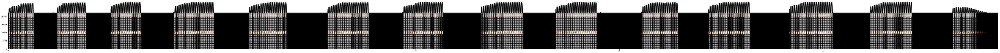

{
  "species_id": "hime-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_hime-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 24.241632653061224,
  "indvs": {
    "hime-suzu": {
      "syllables": {
        "start_times": [0.03, 0.046, 0.062, 0.077, 0.092, 0.108, 0.123, 0.139, 0.155, 0.17, 0.186, 0.202, 0.217, 0.233, 0.249, 0.265, 0.28, 0.295, 0.311, 0.327, 0.342, 0.358, 0.374, 0.389, 0.405, 0.421, 0.437, 0.452, 0.468, 0.484, 0.499, 0.515, 0.531, 0.547, 0.563, 0.579, 0.595, 0.612, 1.197, 1.212, 1.227, 1.242, 1.258, 1.273, 1.289, 1.304, 1.32, 1.335, 1.351, 1.367, 1.382, 1.398, 1.413, 1.429, 1.444, 1.46, 1.476, 1.491, 1.507, 1.522, 1.538, 1.553, 1.569, 1.585, 1.601, 1.616, 1.632, 1.648, 1.664, 1.68, 1.695, 1.711, 1.726, 1.742, 1.758, 1.774, 1.789, 1.805, 1.821, 1.836, 1.852, 1.868, 1.884, 1.9, 2.518, 2.533, 2.548, 2.563, 2.579, 2.594, 2.61, 2.626, 2.641, 2.657, 2.672, 2.688, 2.703, 2.719, 2.735, 2.75, 2.766, 2.781, 2.797, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.8510000000000004
longest vocalization 0.02299999999999991


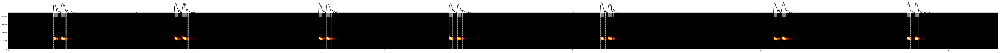

{
  "species_id": "house",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_house_cricket.wav",
  "samplerate_hz": 44100,
  "length_s": 5.25092970521542,
  "indvs": {
    "house": {
      "syllables": {
        "start_times": [0.241, 0.26, 0.282, 0.306, 0.885, 0.926, 0.954, 0.959, 1.652, 1.692, 1.718, 2.345, 2.388, 2.412, 3.149, 3.172, 3.19, 3.216, 4.07, 4.112, 4.779, 4.797, 4.821],
        "end_times": [0.258, 0.264, 0.304, 0.31, 0.903, 0.949, 0.957, 0.962, 1.668, 1.712, 1.721, 2.362, 2.407, 2.415, 3.167, 3.175, 3.208, 3.219, 4.088, 4.134, 4.796, 4.8, 4.84]
      }
    }
  }
}
kamado


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.7119999999999962
longest vocalization 0.014000000000002899


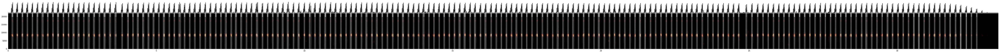

{
  "species_id": "kamado",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kamado.wav",
  "samplerate_hz": 44100,
  "length_s": 33.332244897959185,
  "indvs": {
    "kamado": {
      "syllables": {
        "start_times": [0.124, 0.148, 0.292, 0.315, 0.463, 0.487, 0.633, 0.656, 0.802, 0.824, 0.957, 0.975, 0.998, 1.131, 1.149, 1.173, 1.32, 1.343, 1.494, 1.517, 1.655, 1.672, 1.696, 1.848, 1.87, 2.02, 2.044, 2.178, 2.195, 2.218, 2.35, 2.367, 2.39, 2.535, 2.56, 2.69, 2.707, 2.731, 2.868, 2.885, 2.908, 3.059, 3.083, 3.225, 3.243, 3.267, 3.407, 3.425, 3.449, 3.592, 3.61, 3.634, 3.83, 3.854, 4.021, 4.044, 4.057, 4.194, 4.218, 4.35, 4.368, 4.391, 4.529, 4.547, 4.57, 4.705, 4.722, 4.744, 4.879, 4.896, 4.919, 5.07, 5.093, 5.229, 5.246, 5.27, 5.42, 5.443, 5.589, 5.612, 5.756, 5.778, 5.813, 5.937, 5.958, 6.109, 6.131, 6.282, 6.306, 6.458, 6.482, 6.635, 6.659, 6.795, 6.811, 6.834, 6.989, 7.013, 7.162, 7.185, 7.317, 7.335, 7.358, 7.507, 7.529,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4139999999999979
longest vocalization 0.04300000000000015


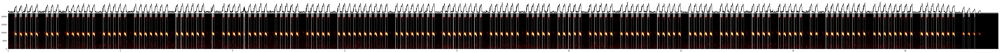

{
  "species_id": "kawara-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kawara-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 17.615238095238094,
  "indvs": {
    "kawara-suzu": {
      "syllables": {
        "start_times": [0.119, 0.124, 0.203, 0.209, 0.302, 0.308, 0.395, 0.4, 0.489, 0.493, 0.673, 0.68, 0.765, 0.77, 0.86, 0.865, 1.049, 1.139, 1.227, 1.323, 1.408, 1.413, 1.503, 1.509, 1.692, 1.696, 1.78, 1.785, 1.873, 1.877, 1.967, 1.972, 2.066, 2.248, 2.252, 2.337, 2.341, 2.429, 2.434, 2.527, 2.62, 2.716, 2.803, 2.808, 2.986, 2.992, 2.996, 3.078, 3.083, 3.088, 3.171, 3.176, 3.269, 3.358, 3.363, 3.452, 3.457, 3.634, 3.639, 3.644, 3.825, 3.829, 3.916, 3.92, 4.01, 4.105, 4.198, 4.203, 4.209, 4.218, 4.286, 4.291, 4.388, 4.476, 4.482, 4.577, 4.761, 4.851, 4.855, 4.94, 4.944, 5.031, 5.037, 5.042, 5.137, 5.321, 5.406, 5.411, 5.5, 5.506, 5.594, 5.599, 5.694, 5.874, 5.879, 5.884, 5.967, 5.973, 6.065, 6.159, 6.163, 6.254, 6.3

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.7279999999999998
longest vocalization 0.02400000000000002


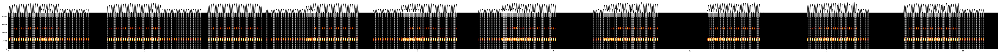

{
  "species_id": "kaya-hibari",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kaya-hibari.wav",
  "samplerate_hz": 44100,
  "length_s": 14.483446712018141,
  "indvs": {
    "kaya-hibari": {
      "syllables": {
        "start_times": [0.012, 0.036, 0.062, 0.088, 0.114, 0.14, 0.165, 0.191, 0.217, 0.243, 0.268, 0.294, 0.32, 0.346, 0.371, 0.397, 0.423, 0.449, 0.475, 0.501, 0.526, 0.539, 0.552, 0.578, 0.604, 0.63, 0.643, 0.656, 0.682, 0.708, 0.734, 0.765, 0.792, 0.816, 0.842, 0.867, 0.893, 0.918, 0.943, 0.969, 0.994, 1.02, 1.045, 1.071, 1.096, 1.121, 1.146, 1.172, 1.456, 1.482, 1.507, 1.532, 1.558, 1.584, 1.61, 1.635, 1.661, 1.687, 1.713, 1.739, 1.765, 1.79, 1.816, 1.841, 1.867, 1.893, 1.919, 1.945, 1.971, 1.997, 2.023, 2.049, 2.074, 2.1, 2.126, 2.152, 2.178, 2.204, 2.231, 2.26, 2.286, 2.31, 2.335, 2.36, 2.387, 2.412, 2.437, 2.463, 2.488, 2.514, 2.539, 2.565, 2.59, 2.615, 2.641, 2.665, 2.69, 2.716, 2.741, 2.767, 2.793, 2.818, 2.92

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.3550000000000004
longest vocalization 0.030000000000001137


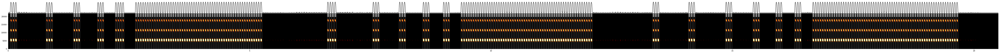

{
  "species_id": "kinhibari",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kinhibari.wav",
  "samplerate_hz": 44100,
  "length_s": 20.45387755102041,
  "indvs": {
    "kinhibari": {
      "syllables": {
        "start_times": [0.045, 0.096, 0.146, 0.787, 0.838, 0.889, 1.356, 1.406, 1.456, 1.85, 1.9, 1.949, 2.219, 2.268, 2.317, 2.366, 2.635, 2.684, 2.733, 2.782, 2.83, 2.878, 2.927, 2.975, 3.023, 3.072, 3.119, 3.167, 3.215, 3.263, 3.311, 3.358, 3.406, 3.454, 3.502, 3.549, 3.596, 3.644, 3.692, 3.741, 3.788, 3.836, 3.884, 3.931, 3.98, 4.027, 4.074, 4.122, 4.171, 4.218, 4.266, 4.313, 4.361, 4.409, 4.457, 4.505, 4.553, 4.601, 4.648, 4.696, 4.744, 4.792, 4.839, 4.887, 4.935, 4.984, 5.031, 5.079, 5.127, 5.175, 5.224, 6.609, 6.659, 6.708, 6.759, 7.551, 7.602, 7.652, 8.096, 8.146, 8.196, 8.589, 8.639, 8.689, 9.008, 9.059, 9.108, 9.377, 9.427, 9.476, 9.525, 9.573, 9.62, 9.669, 9.716, 9.765, 9.813, 9.861, 9.91, 9.958, 10.005, 10.053, 10.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.296000000000001
longest vocalization 0.1200000000000001
Current min_level_db: -40
longest silence 2.298
longest vocalization 0.07200000000000006
Current min_level_db: -35
longest silence 2.34
longest vocalization 0.020999999999999908


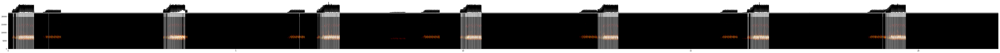

{
  "species_id": "kogata-koorogi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kogata-koorogi.wav",
  "samplerate_hz": 44100,
  "length_s": 21.70482993197279,
  "indvs": {
    "kogata-koorogi": {
      "syllables": {
        "start_times": [0.108, 0.118, 0.128, 0.169, 0.179, 0.189, 0.199, 0.21, 0.22, 0.23, 0.24, 0.25, 0.261, 0.271, 0.282, 0.292, 0.303, 0.314, 0.324, 0.335, 0.346, 0.356, 0.367, 0.377, 0.388, 0.399, 0.409, 0.42, 0.431, 0.441, 0.452, 0.463, 0.474, 0.484, 0.495, 0.506, 0.517, 0.527, 0.538, 0.549, 0.56, 0.889, 3.418, 3.428, 3.438, 3.448, 3.458, 3.468, 3.489, 3.499, 3.509, 3.519, 3.53, 3.54, 3.55, 3.56, 3.57, 3.581, 3.591, 3.602, 3.613, 3.623, 3.634, 3.645, 3.655, 3.666, 3.677, 3.687, 3.698, 3.708, 3.719, 3.73, 3.741, 3.751, 3.762, 3.773, 3.783, 3.794, 3.805, 3.815, 3.837, 3.859, 3.868, 3.879, 6.4, 6.803, 6.834, 6.854, 6.864, 6.875, 6.885, 6.895, 6.905, 6.915, 6.926, 6.936, 6.946, 6.956, 6.967, 6.977, 6.988, 6.998

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 3.9160000000000004
longest vocalization 0.02300000000000324


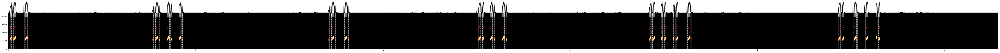

{
  "species_id": "kuchinaga",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kuchinaga.wav",
  "samplerate_hz": 44100,
  "length_s": 26.36625850340136,
  "indvs": {
    "kuchinaga": {
      "syllables": {
        "start_times": [0.056, 0.087, 0.121, 0.156, 0.192, 0.416, 0.446, 0.48, 0.515, 3.881, 3.913, 3.946, 3.981, 4.016, 4.24, 4.273, 4.306, 4.341, 4.564, 4.595, 4.63, 8.58, 8.611, 8.644, 8.679, 8.714, 8.957, 8.991, 9.025, 9.06, 12.539, 12.571, 12.605, 12.64, 12.675, 12.862, 12.893, 12.927, 12.961, 13.182, 13.214, 13.246, 13.282, 17.108, 17.14, 17.174, 17.208, 17.244, 17.434, 17.465, 17.499, 17.534, 17.756, 17.788, 17.82, 17.855, 18.114, 18.145, 18.178, 18.214, 22.152, 22.182, 22.216, 22.25, 22.285, 22.546, 22.576, 22.608, 22.643, 22.86, 22.895, 22.928, 23.172, 23.209, 23.243],
        "end_times": [0.072, 0.108, 0.143, 0.179, 0.215, 0.432, 0.467, 0.502, 0.537, 3.895, 3.933, 3.968, 4.004, 4.039, 4.258, 4.294, 4.329, 4.364, 4.5

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.7880000000000003
longest vocalization 0.015000000000000013


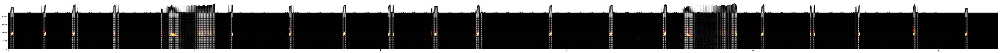

{
  "species_id": "kuma-koorogi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kuma-koorogi.wav",
  "samplerate_hz": 44100,
  "length_s": 26.534603174603173,
  "indvs": {
    "kuma-koorogi": {
      "syllables": {
        "start_times": [0.053, 0.082, 0.113, 0.146, 0.901, 0.931, 0.962, 0.997, 1.716, 1.749, 1.781, 1.814, 1.846, 2.824, 2.855, 2.887, 2.919, 2.953, 4.117, 4.164, 4.188, 4.212, 4.236, 4.26, 4.285, 4.31, 4.335, 4.359, 4.384, 4.41, 4.435, 4.462, 4.486, 4.512, 4.537, 4.564, 4.589, 4.615, 4.641, 4.668, 4.693, 4.72, 4.747, 4.772, 4.798, 4.825, 4.851, 4.877, 4.904, 4.929, 4.957, 4.984, 5.01, 5.036, 5.062, 5.088, 5.114, 5.14, 5.168, 5.194, 5.221, 5.247, 5.275, 5.302, 5.329, 5.356, 5.383, 5.409, 5.435, 5.462, 5.494, 5.517, 5.544, 5.924, 5.953, 5.986, 6.018, 7.552, 7.584, 7.615, 7.648, 8.967, 8.998, 9.03, 9.063, 10.212, 10.242, 10.274, 10.307, 10.34, 11.376, 11.406, 11.44, 11.471, 11.505, 11.536, 12.572, 12.601, 12.632, 12.6

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.3889999999999993
longest vocalization 0.028999999999999915


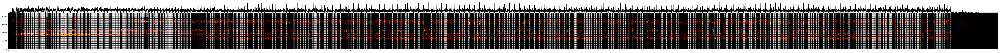

{
  "species_id": "kumasuzumushi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kumasuzumushi.wav",
  "samplerate_hz": 44100,
  "length_s": 28.92045351473923,
  "indvs": {
    "kumasuzumushi": {
      "syllables": {
        "start_times": [0.165, 0.245, 0.255, 0.277, 0.289, 0.353, 0.363, 0.379, 0.46, 0.473, 0.505, 0.516, 0.523, 0.561, 0.585, 0.601, 0.605, 0.622, 0.631, 0.673, 0.681, 0.69, 0.699, 0.709, 0.719, 0.735, 0.74, 0.759, 0.793, 0.798, 0.824, 0.831, 0.86, 0.864, 0.89, 0.904, 0.922, 0.93, 0.949, 0.956, 0.968, 0.979, 1.001, 1.005, 1.017, 1.022, 1.032, 1.043, 1.047, 1.055, 1.061, 1.112, 1.121, 1.128, 1.137, 1.147, 1.16, 1.175, 1.191, 1.216, 1.229, 1.249, 1.268, 1.276, 1.327, 1.337, 1.364, 1.372, 1.382, 1.389, 1.406, 1.426, 1.44, 1.453, 1.463, 1.47, 1.511, 1.533, 1.537, 1.556, 1.561, 1.57, 1.584, 1.599, 1.606, 1.617, 1.635, 1.649, 1.659, 1.673, 1.677, 1.681, 1.688, 1.692, 1.704, 1.718, 1.74, 1.75, 1.759, 1.768, 1.777, 1.79,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    7.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    7.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.375
longest vocalization 0.014000000000000012


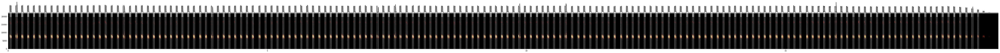

{
  "species_id": "kurotsuya",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kurotsuya.wav",
  "samplerate_hz": 44100,
  "length_s": 19.054875283446712,
  "indvs": {
    "kurotsuya": {
      "syllables": {
        "start_times": [0.032, 0.051, 0.145, 0.169, 0.256, 0.275, 0.37, 0.389, 0.482, 0.501, 0.592, 0.612, 0.703, 0.722, 0.824, 0.843, 0.939, 0.958, 1.059, 1.078, 1.176, 1.195, 1.291, 1.309, 1.402, 1.421, 1.52, 1.539, 1.637, 1.656, 1.751, 1.77, 1.866, 1.886, 1.983, 2.002, 2.103, 2.122, 2.216, 2.243, 2.337, 2.356, 2.453, 2.472, 2.565, 2.585, 2.683, 2.702, 2.795, 2.814, 2.909, 2.928, 3.02, 3.039, 3.125, 3.144, 3.237, 3.256, 3.344, 3.363, 3.459, 3.478, 3.569, 3.588, 3.689, 3.708, 3.799, 3.819, 3.916, 3.944, 4.032, 4.052, 4.143, 4.162, 4.252, 4.271, 4.363, 4.382, 4.478, 4.497, 4.591, 4.61, 4.704, 4.723, 4.833, 4.852, 4.952, 4.971, 5.067, 5.086, 5.181, 5.2, 5.291, 5.31, 5.412, 5.431, 5.527, 5.546, 5.641, 5.66, 5.754, 5.774, 5.867,

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.4s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 4.026
longest vocalization 0.019000000000000128


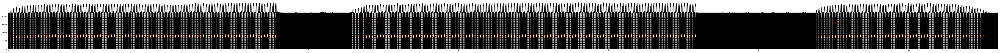

{
  "species_id": "kusahibari",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_kusahibari.wav",
  "samplerate_hz": 44100,
  "length_s": 32.905578231292516,
  "indvs": {
    "kusahibari": {
      "syllables": {
        "start_times": [0.068, 0.174, 0.221, 0.272, 0.324, 0.376, 0.429, 0.48, 0.532, 0.584, 0.637, 0.689, 0.742, 0.793, 0.846, 0.899, 0.953, 1.001, 1.053, 1.105, 1.157, 1.209, 1.26, 1.313, 1.364, 1.416, 1.468, 1.519, 1.571, 1.623, 1.674, 1.726, 1.778, 1.83, 1.882, 1.934, 1.985, 2.037, 2.089, 2.141, 2.192, 2.243, 2.295, 2.347, 2.399, 2.45, 2.502, 2.553, 2.605, 2.656, 2.709, 2.76, 2.812, 2.864, 2.916, 2.967, 3.019, 3.071, 3.123, 3.174, 3.227, 3.279, 3.33, 3.382, 3.434, 3.485, 3.537, 3.588, 3.641, 3.693, 3.744, 3.796, 3.848, 3.901, 3.952, 4.004, 4.056, 4.108, 4.16, 4.212, 4.265, 4.317, 4.367, 4.419, 4.47, 4.521, 4.573, 4.624, 4.677, 4.729, 4.78, 4.833, 4.884, 4.936, 4.989, 5.041, 5.093, 5.145, 5.197, 5.249, 5.301, 5.354, 5.4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.0940000000000012
longest vocalization 0.053000000000000824
Current min_level_db: -40
longest silence 1.0940000000000012
longest vocalization 0.020000000000000462


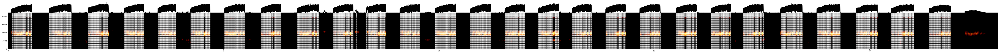

{
  "species_id": "madara-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_madara-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 22.935510204081634,
  "indvs": {
    "madara-suzu": {
      "syllables": {
        "start_times": [0.07, 0.095, 0.101, 0.107, 0.126, 0.132, 0.138, 0.145, 0.151, 0.157, 0.163, 0.17, 0.176, 0.182, 0.189, 0.195, 0.201, 0.208, 0.214, 0.22, 0.227, 0.233, 0.239, 0.245, 0.252, 0.258, 0.265, 0.271, 0.277, 0.284, 0.29, 0.297, 0.303, 0.31, 0.316, 0.323, 0.329, 0.336, 0.343, 0.349, 0.356, 0.362, 0.369, 0.376, 0.382, 0.389, 0.396, 0.403, 0.409, 0.416, 0.423, 0.43, 0.437, 0.444, 0.451, 0.457, 0.464, 0.471, 0.478, 0.486, 0.492, 0.499, 0.506, 0.513, 0.52, 0.527, 0.535, 0.542, 0.946, 0.953, 0.959, 0.965, 0.972, 0.978, 0.984, 0.99, 0.996, 1.003, 1.009, 1.015, 1.021, 1.028, 1.034, 1.04, 1.047, 1.053, 1.059, 1.065, 1.072, 1.078, 1.084, 1.091, 1.097, 1.103, 1.11, 1.116, 1.122, 1.128, 1.135, 1.141, 1.147, 1.154, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   14.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   14.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.556000000000001
longest vocalization 0.014000000000002899


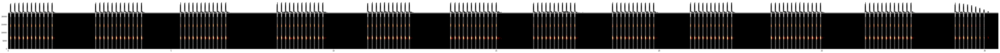

{
  "species_id": "mitsukado",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_mitsukado.wav",
  "samplerate_hz": 44100,
  "length_s": 30.34848072562358,
  "indvs": {
    "mitsukado": {
      "syllables": {
        "start_times": [0.063, 0.077, 0.193, 0.207, 0.319, 0.333, 0.448, 0.463, 0.576, 0.591, 0.705, 0.72, 0.831, 0.845, 0.956, 0.971, 1.083, 1.098, 1.21, 1.226, 1.339, 1.353, 2.676, 2.69, 2.805, 2.819, 2.929, 2.944, 3.053, 3.068, 3.182, 3.198, 3.308, 3.323, 3.437, 3.452, 3.565, 3.579, 3.693, 3.707, 3.826, 3.84, 3.954, 3.968, 4.085, 4.1, 5.283, 5.298, 5.416, 5.43, 5.543, 5.558, 5.666, 5.681, 5.791, 5.805, 5.916, 5.931, 6.039, 6.055, 6.164, 6.179, 6.288, 6.303, 6.415, 6.431, 6.541, 6.557, 6.671, 6.687, 8.255, 8.269, 8.386, 8.401, 8.512, 8.527, 8.636, 8.651, 8.763, 8.779, 8.889, 8.904, 9.013, 9.028, 9.14, 9.156, 9.267, 9.282, 9.395, 9.41, 9.524, 9.539, 9.655, 9.67, 11.036, 11.05, 11.173, 11.188, 11.301, 11.316, 11.426, 11.441, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.857000000000001
longest vocalization 0.012000000000000455


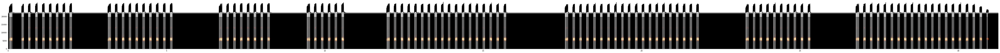

{
  "species_id": "moriokame2",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_moriokame2.wav",
  "samplerate_hz": 44100,
  "length_s": 31.187301587301587,
  "indvs": {
    "moriokame2": {
      "syllables": {
        "start_times": [0.032, 0.044, 0.056, 0.068, 0.081, 0.092, 0.109, 0.12, 0.424, 0.435, 0.448, 0.459, 0.473, 0.484, 0.633, 0.644, 0.656, 0.668, 0.681, 0.693, 0.857, 0.867, 0.88, 0.892, 0.905, 0.918, 1.076, 1.087, 1.101, 1.113, 1.127, 1.139, 1.293, 1.304, 1.318, 1.329, 1.344, 1.356, 1.511, 1.522, 1.535, 1.546, 1.561, 1.573, 1.724, 1.736, 1.749, 1.76, 1.775, 1.787, 1.94, 1.95, 1.964, 1.975, 1.99, 2.002, 3.147, 3.159, 3.171, 3.182, 3.194, 3.206, 3.222, 3.233, 3.378, 3.388, 3.401, 3.413, 3.427, 3.439, 3.593, 3.603, 3.616, 3.627, 3.641, 3.654, 3.807, 3.818, 3.831, 3.843, 3.858, 3.87, 4.024, 4.035, 4.049, 4.06, 4.075, 4.087, 4.24, 4.251, 4.265, 4.277, 4.291, 4.304, 4.454, 4.465, 4.478, 4.49, 4.505, 4.517, 4.671, 4.682, 4.69

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2839999999999998
longest vocalization 0.03600000000000003


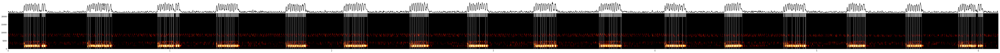

{
  "species_id": "northern",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_northern_mole_cricket.wav",
  "samplerate_hz": 44100,
  "length_s": 6.108117913832199,
  "indvs": {
    "northern": {
      "syllables": {
        "start_times": [0.097, 0.106, 0.118, 0.128, 0.139, 0.161, 0.172, 0.185, 0.208, 0.219, 0.488, 0.497, 0.508, 0.543, 0.553, 0.564, 0.577, 0.598, 0.61, 0.628, 0.923, 0.933, 0.944, 0.967, 0.977, 1.001, 1.011, 1.022, 1.036, 1.045, 1.287, 1.297, 1.308, 1.319, 1.342, 1.353, 1.363, 1.375, 1.386, 1.397, 1.717, 1.727, 1.736, 1.749, 1.76, 1.771, 1.781, 1.795, 1.806, 1.817, 1.828, 2.076, 2.086, 2.097, 2.107, 2.131, 2.141, 2.151, 2.165, 2.175, 2.187, 2.2, 2.483, 2.493, 2.503, 2.514, 2.526, 2.537, 2.548, 2.56, 2.571, 2.585, 2.84, 2.85, 2.86, 2.87, 2.882, 2.894, 2.915, 2.954, 3.251, 3.261, 3.272, 3.293, 3.305, 3.316, 3.328, 3.35, 3.362, 3.379, 3.654, 3.664, 3.673, 3.684, 3.718, 3.73, 3.743, 3.753, 3.765, 3.79, 4.06, 4.069, 4

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.5090000000000003
longest vocalization 0.015000000000000568


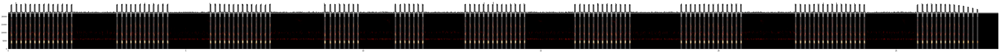

{
  "species_id": "oookame",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_oookame.wav",
  "samplerate_hz": 44100,
  "length_s": 27.811700680272107,
  "indvs": {
    "oookame": {
      "syllables": {
        "start_times": [0.075, 0.097, 0.218, 0.24, 0.347, 0.369, 0.478, 0.498, 0.605, 0.628, 0.732, 0.755, 0.861, 0.883, 0.991, 1.013, 1.122, 1.143, 1.251, 1.273, 1.381, 1.402, 1.51, 1.531, 1.638, 1.661, 1.769, 1.791, 3.05, 3.072, 3.187, 3.208, 3.315, 3.335, 3.44, 3.461, 3.568, 3.589, 3.697, 3.719, 3.825, 3.847, 3.953, 3.976, 4.079, 4.102, 4.209, 4.23, 4.34, 4.361, 4.47, 4.492, 5.682, 5.702, 5.817, 5.839, 5.947, 5.968, 6.075, 6.097, 6.204, 6.225, 6.329, 6.351, 6.46, 6.48, 6.586, 6.608, 6.715, 6.737, 6.84, 6.86, 6.968, 6.99, 7.097, 7.119, 7.227, 7.248, 7.356, 7.377, 8.9, 8.924, 9.054, 9.076, 9.189, 9.209, 9.319, 9.34, 9.448, 9.471, 9.575, 9.597, 9.706, 9.726, 9.831, 9.854, 10.888, 10.907, 11.023, 11.045, 11.152, 11.174, 11.278, 11.2

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.8s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.3559999999999981
longest vocalization 0.007000000000000561


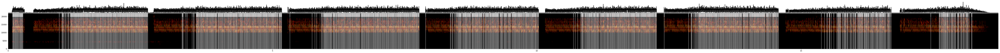

{
  "species_id": "shiba-suzu",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_shiba-suzu.wav",
  "samplerate_hz": 44100,
  "length_s": 18.683356009070295,
  "indvs": {
    "shiba-suzu": {
      "syllables": {
        "start_times": [0.082, 0.09, 0.099, 0.107, 0.116, 0.125, 0.134, 0.142, 0.151, 0.16, 0.169, 0.178, 0.187, 0.196, 0.204, 0.213, 0.222, 0.231, 0.24, 0.249, 0.257, 0.266, 0.276, 0.964, 1.016, 1.025, 1.034, 1.042, 1.069, 1.077, 1.095, 1.12, 1.137, 1.146, 1.172, 1.18, 1.189, 1.198, 1.207, 1.215, 1.224, 1.232, 1.241, 1.25, 1.259, 1.267, 1.276, 1.284, 1.293, 1.301, 1.31, 1.319, 1.328, 1.336, 1.345, 1.353, 1.362, 1.371, 1.379, 1.388, 1.397, 1.405, 1.414, 1.423, 1.431, 1.44, 1.448, 1.457, 1.466, 1.475, 1.483, 1.492, 1.5, 1.509, 1.518, 1.526, 1.535, 1.544, 1.552, 1.561, 1.57, 1.578, 1.587, 1.596, 1.604, 1.613, 1.622, 1.63, 1.639, 1.647, 1.656, 1.665, 1.674, 1.682, 1.691, 1.7, 1.709, 1.717, 1.726, 1.735, 1.743, 1.752, 1.761, 1

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    9.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    9.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.15600000000000014
longest vocalization 0.028999999999999915
Current min_level_db: -40
longest silence 0.15600000000000014
longest vocalization 0.02400000000000002
Current min_level_db: -35
longest silence 0.15799999999999992
longest vocalization 0.01200000000000001
Current min_level_db: -30
longest silence 0.1750000000000007
longest vocalization 0.009000000000000008
Current min_level_db: -25
longest silence 0.5250000000000004
longest vocalization 0.007000000000000006


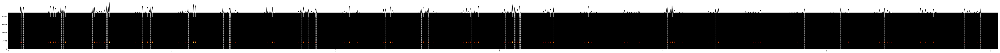

{
  "species_id": "snowy",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_snowy_tree_cricket_hot.wav",
  "samplerate_hz": 44100,
  "length_s": 6.033560090702948,
  "indvs": {
    "snowy": {
      "syllables": {
        "start_times": [0.076, 0.093, 0.256, 0.276, 0.288, 0.321, 0.334, 0.347, 0.512, 0.523, 0.601, 0.614, 0.82, 0.849, 0.865, 0.878, 1.098, 1.13, 1.141, 1.311, 1.352, 1.579, 1.613, 1.788, 1.801, 1.832, 1.877, 2.083, 2.303, 2.334, 2.349, 2.521, 2.535, 2.564, 2.823, 2.87, 3.033, 3.077, 3.093, 3.123, 3.31, 3.329, 3.544, 4.023, 4.054, 4.322, 4.865, 5.085, 5.352, 5.651, 5.842, 5.937],
        "end_times": [0.081, 0.097, 0.262, 0.279, 0.292, 0.325, 0.337, 0.353, 0.515, 0.529, 0.606, 0.621, 0.824, 0.854, 0.87, 0.884, 1.101, 1.134, 1.147, 1.315, 1.358, 1.583, 1.616, 1.791, 1.806, 1.835, 1.883, 2.088, 2.306, 2.338, 2.352, 2.525, 2.54, 2.568, 2.829, 2.876, 3.037, 3.082, 3.098, 3.129, 3.316, 3.332, 3.549, 4.028, 4.059, 4.325, 4.86

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s remaining:    0.0s


longest silence 0.5990000000000002
longest vocalization 0.02400000000000002


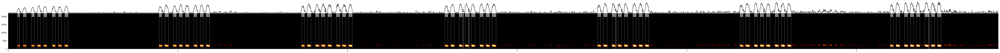

{
  "species_id": "snowy",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_snowy_tree_cricket_cold.wav",
  "samplerate_hz": 44100,
  "length_s": 5.822947845804989,
  "indvs": {
    "snowy": {
      "syllables": {
        "start_times": [0.056, 0.089, 0.138, 0.174, 0.21, 0.26, 0.296, 0.334, 0.89, 0.924, 0.973, 1.008, 1.045, 1.095, 1.132, 1.168, 1.73, 1.764, 1.812, 1.846, 1.884, 1.934, 1.971, 2.008, 2.575, 2.61, 2.658, 2.681, 2.694, 2.716, 2.732, 2.781, 2.817, 2.853, 3.475, 3.51, 3.561, 3.582, 3.596, 3.632, 3.683, 3.719, 3.755, 4.315, 4.348, 4.399, 4.433, 4.47, 4.521, 4.558, 4.594, 5.201, 5.235, 5.284, 5.318, 5.355, 5.404, 5.428, 5.442, 5.479],
        "end_times": [0.067, 0.106, 0.154, 0.19, 0.227, 0.277, 0.314, 0.353, 0.905, 0.945, 0.991, 1.027, 1.066, 1.112, 1.15, 1.188, 1.746, 1.785, 1.832, 1.868, 1.906, 1.954, 1.99, 2.029, 2.592, 2.631, 2.677, 2.684, 2.714, 2.719, 2.752, 2.801, 2.837, 2.876, 3.493, 3.532, 3.579, 3.585, 3.615, 

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.7670000000000001
longest vocalization 0.025000000000000355


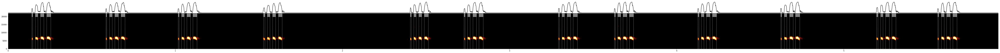

{
  "species_id": "spring",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_spring_field_cricket.wav",
  "samplerate_hz": 44100,
  "length_s": 5.9098412698412695,
  "indvs": {
    "spring": {
      "syllables": {
        "start_times": [0.142, 0.163, 0.194, 0.231, 0.585, 0.606, 0.638, 0.676, 1.017, 1.038, 1.069, 1.106, 1.528, 1.55, 1.582, 1.617, 2.406, 2.427, 2.457, 2.49, 2.728, 2.749, 2.781, 2.817, 3.293, 3.314, 3.345, 3.381, 3.628, 3.647, 3.679, 3.717, 4.127, 4.147, 4.178, 4.214, 4.623, 4.644, 4.676, 4.711, 5.196, 5.22, 5.25, 5.287, 5.562, 5.583, 5.615, 5.653],
        "end_times": [0.147, 0.178, 0.214, 0.255, 0.59, 0.622, 0.66, 0.699, 1.023, 1.053, 1.091, 1.13, 1.536, 1.566, 1.6, 1.639, 2.412, 2.441, 2.474, 2.514, 2.734, 2.764, 2.802, 2.842, 3.299, 3.329, 3.366, 3.406, 3.633, 3.665, 3.702, 3.742, 4.133, 4.163, 4.199, 4.238, 4.628, 4.659, 4.697, 4.736, 5.205, 5.234, 5.272, 5.312, 5.568, 5.6, 5.637, 5.677]
      }
    }
  }
}
ta

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.216000000000001
longest vocalization 0.08200000000000074
Current min_level_db: -40
longest silence 1.216000000000001
longest vocalization 0.04200000000000159


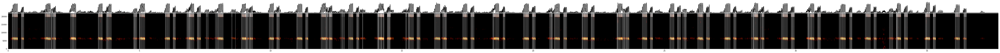

{
  "species_id": "taiwan-enma",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_taiwan-enma.wav",
  "samplerate_hz": 44100,
  "length_s": 37.62793650793651,
  "indvs": {
    "taiwan-enma": {
      "syllables": {
        "start_times": [0.149, 0.179, 0.215, 0.254, 0.293, 0.335, 0.502, 0.521, 0.547, 0.574, 1.402, 1.427, 1.469, 1.502, 1.54, 1.581, 1.638, 1.647, 1.677, 1.719, 1.743, 1.768, 1.795, 2.374, 2.404, 2.439, 2.47, 2.478, 2.517, 2.557, 3.428, 3.451, 3.488, 3.527, 3.566, 3.731, 3.753, 3.778, 3.802, 3.836, 3.871, 3.91, 4.775, 4.81, 4.814, 4.821, 4.848, 4.854, 4.891, 4.997, 5.004, 5.024, 5.061, 5.098, 5.138, 5.179, 5.981, 6.01, 6.048, 6.086, 6.128, 6.282, 6.305, 6.33, 6.358, 6.793, 6.834, 6.846, 6.852, 6.881, 6.888, 6.905, 6.924, 6.929, 6.967, 6.973, 7.011, 7.052, 7.202, 7.225, 7.246, 7.274, 7.311, 7.547, 7.588, 7.63, 7.887, 7.923, 7.927, 7.97, 7.982, 8.01, 8.047, 8.086, 8.125, 8.168, 8.521, 8.652, 8.882, 8.909, 8.946, 8.986, 9

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.8219999999999992
longest vocalization 0.02000000000000135


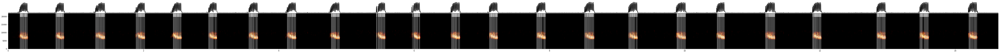

{
  "species_id": "tanbo-koorogi",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_tanbo-koorogi.wav",
  "samplerate_hz": 44100,
  "length_s": 14.59954648526077,
  "indvs": {
    "tanbo-koorogi": {
      "syllables": {
        "start_times": [0.174, 0.183, 0.192, 0.201, 0.21, 0.22, 0.229, 0.239, 0.249, 0.258, 0.269, 0.279, 0.703, 0.712, 0.72, 0.728, 0.737, 0.746, 0.756, 0.765, 0.775, 0.785, 0.795, 0.806, 0.816, 1.29, 1.298, 1.306, 1.315, 1.324, 1.332, 1.342, 1.351, 1.361, 1.371, 1.381, 1.391, 1.401, 1.411, 1.422, 1.889, 1.897, 1.906, 1.914, 1.922, 1.932, 1.941, 1.951, 1.961, 1.97, 1.979, 1.99, 2.0, 2.011, 2.437, 2.445, 2.453, 2.462, 2.471, 2.481, 2.491, 2.5, 2.51, 2.52, 2.53, 2.541, 2.551, 2.961, 2.97, 2.978, 2.986, 2.995, 3.004, 3.014, 3.024, 3.033, 3.053, 3.063, 3.074, 3.557, 3.565, 3.574, 3.582, 3.591, 3.6, 3.609, 3.619, 3.629, 3.638, 3.658, 3.669, 3.679, 4.123, 4.131, 4.139, 4.147, 4.156, 4.165, 4.174, 4.185, 4.194, 4.204, 4.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 2.0809999999999995
longest vocalization 0.014000000000002899


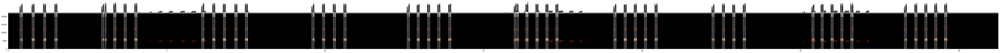

{
  "species_id": "tanbookame",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_tanbookame_kugirinaki.wav",
  "samplerate_hz": 44100,
  "length_s": 31.164081632653062,
  "indvs": {
    "tanbookame": {
      "syllables": {
        "start_times": [0.368, 0.392, 0.419, 0.44, 0.746, 0.767, 0.795, 0.816, 1.108, 1.13, 1.157, 1.179, 1.465, 1.488, 1.516, 1.538, 2.947, 2.97, 2.996, 3.017, 3.061, 3.083, 3.323, 3.345, 3.372, 3.394, 3.65, 3.672, 3.7, 3.722, 3.987, 4.009, 4.037, 4.059, 6.098, 6.12, 6.148, 6.17, 6.445, 6.468, 6.495, 6.517, 6.778, 6.801, 6.828, 6.849, 7.145, 7.167, 7.195, 7.217, 7.475, 7.498, 7.526, 7.548, 9.572, 9.595, 9.623, 9.643, 9.909, 9.932, 9.959, 9.981, 10.25, 10.271, 10.3, 10.321, 10.584, 10.605, 10.634, 10.656, 12.583, 12.608, 12.634, 12.654, 12.895, 12.917, 12.944, 12.966, 13.222, 13.244, 13.272, 13.294, 13.545, 13.567, 13.596, 13.617, 13.888, 13.91, 13.94, 13.961, 15.957, 15.979, 16.007, 16.028, 16.065, 16.086, 16.3

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.2370000000000001
longest vocalization 0.027000000000000135
Current min_level_db: -40
longest silence 0.2760000000000007
longest vocalization 0.02499999999999991


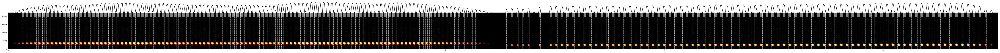

{
  "species_id": "treecricket",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_treecricket.wav",
  "samplerate_hz": 44100,
  "length_s": 9.032607709750566,
  "indvs": {
    "treecricket": {
      "syllables": {
        "start_times": [0.129, 0.137, 0.165, 0.202, 0.238, 0.276, 0.313, 0.351, 0.389, 0.427, 0.465, 0.502, 0.54, 0.578, 0.615, 0.653, 0.691, 0.729, 0.766, 0.804, 0.841, 0.879, 0.917, 0.954, 0.992, 1.029, 1.067, 1.104, 1.143, 1.18, 1.217, 1.255, 1.293, 1.33, 1.368, 1.405, 1.443, 1.481, 1.518, 1.556, 1.593, 1.631, 1.669, 1.707, 1.744, 1.782, 1.82, 1.856, 1.898, 1.936, 1.974, 2.012, 2.05, 2.087, 2.125, 2.162, 2.2, 2.238, 2.275, 2.313, 2.35, 2.387, 2.425, 2.463, 2.5, 2.538, 2.576, 2.613, 2.651, 2.688, 2.726, 2.763, 2.801, 2.838, 2.876, 2.914, 2.951, 2.989, 3.026, 3.063, 3.101, 3.138, 3.176, 3.214, 3.251, 3.289, 3.327, 3.364, 3.402, 3.439, 3.477, 3.514, 3.552, 3.589, 3.627, 3.665, 3.703, 3.74, 3.778, 3.816, 3.853, 3.891, 3.9

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 3.8119999999999994
longest vocalization 0.01600000000000179


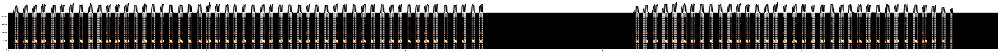

{
  "species_id": "tsuzuresase",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_tsuzuresase.wav",
  "samplerate_hz": 44100,
  "length_s": 24.90920634920635,
  "indvs": {
    "tsuzuresase": {
      "syllables": {
        "start_times": [0.167, 0.184, 0.204, 0.224, 0.243, 0.381, 0.4, 0.418, 0.435, 0.455, 0.475, 0.608, 0.627, 0.646, 0.664, 0.684, 0.704, 0.84, 0.859, 0.878, 0.898, 0.916, 0.938, 1.086, 1.103, 1.123, 1.144, 1.161, 1.182, 1.319, 1.338, 1.356, 1.375, 1.396, 1.415, 1.548, 1.567, 1.585, 1.605, 1.625, 1.645, 1.784, 1.803, 1.82, 1.84, 1.86, 1.88, 2.015, 2.035, 2.052, 2.072, 2.093, 2.112, 2.243, 2.262, 2.28, 2.3, 2.32, 2.34, 2.477, 2.496, 2.514, 2.533, 2.553, 2.573, 2.703, 2.723, 2.741, 2.76, 2.78, 2.8, 2.934, 2.955, 2.973, 2.991, 3.011, 3.031, 3.167, 3.186, 3.204, 3.224, 3.244, 3.382, 3.401, 3.419, 3.438, 3.458, 3.478, 3.617, 3.636, 3.655, 3.674, 3.694, 3.835, 3.854, 3.872, 3.892, 3.911, 4.052, 4.07, 4.087, 4.108, 4.127, 4.

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.0s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 0.4759999999999991
longest vocalization 0.011000000000001009


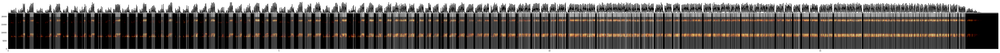

{
  "species_id": "yamato-hibari",
  "species": "Gryllidae sp.",
  "common_name": "cricket",
  "wav_loc": "/mnt/cube/Datasets/insectORIG/CR_yamato-hibari.wav",
  "samplerate_hz": 44100,
  "length_s": 18.2421768707483,
  "indvs": {
    "yamato-hibari": {
      "syllables": {
        "start_times": [0.142, 0.276, 0.29, 0.303, 0.396, 0.408, 0.421, 0.434, 0.447, 0.46, 0.599, 0.762, 0.775, 0.788, 0.842, 0.874, 0.887, 0.899, 0.913, 0.925, 0.938, 0.951, 1.09, 1.103, 1.227, 1.241, 1.255, 1.274, 1.366, 1.405, 1.417, 1.438, 1.529, 1.542, 1.554, 1.568, 1.58, 1.668, 1.707, 1.72, 1.864, 1.897, 1.981, 1.994, 2.007, 2.02, 2.034, 2.046, 2.06, 2.198, 2.211, 2.225, 2.356, 2.368, 2.381, 2.492, 2.506, 2.519, 2.532, 2.544, 2.651, 2.664, 2.676, 2.69, 2.703, 2.828, 2.84, 2.855, 2.867, 2.959, 2.972, 2.985, 2.997, 3.011, 3.024, 3.131, 3.156, 3.17, 3.287, 3.299, 3.326, 3.424, 3.437, 3.45, 3.463, 3.476, 3.489, 3.614, 3.627, 3.64, 3.653, 3.714, 3.734, 3.745, 3.758, 3.772, 3.784, 3.797, 3.811, 3.878, 3.95, 3.982, 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.8s finished


In [92]:
nex = 3
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv][:nex]

    joblib.Parallel(n_jobs=1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], plot=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

### Generate for full dataset

In [ ]:
nex = -1
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv]

    joblib.Parallel(n_jobs=-1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], save=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

437ss


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


438ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.7s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


440ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    6.2s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


441ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    8.3s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


442ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    8.9s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    8.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


443ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   10.3s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


446ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   10.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


450ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:   10.7s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


452ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.8s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    9.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.


453ss


[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    8.9s
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    8.9s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 24 concurrent workers.
